In [1]:
!mkdir data
!wget http://cf.10xgenomics.com/samples/cell-exp/1.1.0/pbmc3k/pbmc3k_filtered_gene_bc_matrices.tar.gz -O data/pbmc3k_filtered_gene_bc_matrices.tar.gz
!cd data; tar -xzf pbmc3k_filtered_gene_bc_matrices.tar.gz
!mkdir write

mkdir: cannot create directory ‘data’: File exists
--2024-04-10 08:37:41--  http://cf.10xgenomics.com/samples/cell-exp/1.1.0/pbmc3k/pbmc3k_filtered_gene_bc_matrices.tar.gz
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://cf.10xgenomics.com/samples/cell-exp/1.1.0/pbmc3k/pbmc3k_filtered_gene_bc_matrices.tar.gz [following]
--2024-04-10 08:37:41--  https://cf.10xgenomics.com/samples/cell-exp/1.1.0/pbmc3k/pbmc3k_filtered_gene_bc_matrices.tar.gz
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7621991 (7.3M) [application/x-tar]
Saving to: ‘data/pbmc3k_filtered_gene_bc_matrices.tar.gz’

data/pbmc3k_filtere 100%[===================>]   7.27M  --.-KB/s    in 0.08s   

2024-04-10 08:37:42

In [2]:
!pip install anndata
!pip install scanpy


  Using cached anndata-0.10.7-py3-none-any.whl (122 kB)
  Using cached array_api_compat-1.6-py3-none-any.whl (36 kB)
  Using cached natsort-8.4.0-py3-none-any.whl (38 kB)
  Using cached scanpy-1.10.1-py3-none-any.whl (2.1 MB)
  Using cached legacy_api_wrap-1.4-py3-none-any.whl (15 kB)
  Using cached numba-0.59.1-cp310-cp310-manylinux2014_x86_64.manylinux_2_17_x86_64.whl (3.7 MB)
  Using cached pynndescent-0.5.12-py3-none-any.whl (56 kB)
  Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)
  Using cached session_info-1.0.0-py3-none-any.whl
  Using cached umap_learn-0.5.6-py3-none-any.whl (85 kB)
  Using cached llvmlite-0.42.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (43.8 MB)
  Using cached stdlib_list-0.10.0-py3-none-any.whl (79 kB)
  Attempting uninstall: seaborn
    Found existing installation: seaborn 0.12.2
    Uninstalling seaborn-0.12.2:
      Successfully uninstalled seaborn-0.12.2


In [3]:
import anndata as ad
import matplotlib.pyplot as plt
import pooch
import scanpy as sc
import pandas as pd



In [4]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=200, facecolor="white")

2024-04-10 08:38:19.249422: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.24.3 scipy==1.10.1 pandas==2.0.2 scikit-learn==1.2.2 statsmodels==0.14.0 pynndescent==0.5.12


In [5]:
results_file = "write/pbmc3k.h5ad"  # the file that will store the analysis results

In [6]:
adata = sc.datasets.pbmc3k_processed().raw.to_adata()
adata.obs_names_make_unique()

In [7]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [8]:
adata

AnnData object with n_obs × n_vars = 2638 × 13714
    obs: 'n_genes', 'percent_mito', 'n_counts', 'louvain'
    var: 'n_cells'
    uns: 'draw_graph', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'X_draw_graph_fr'
    obsp: 'distances', 'connectivities'

(2638, 13714)
None
normalizing counts per cell
    finished (0:00:00)


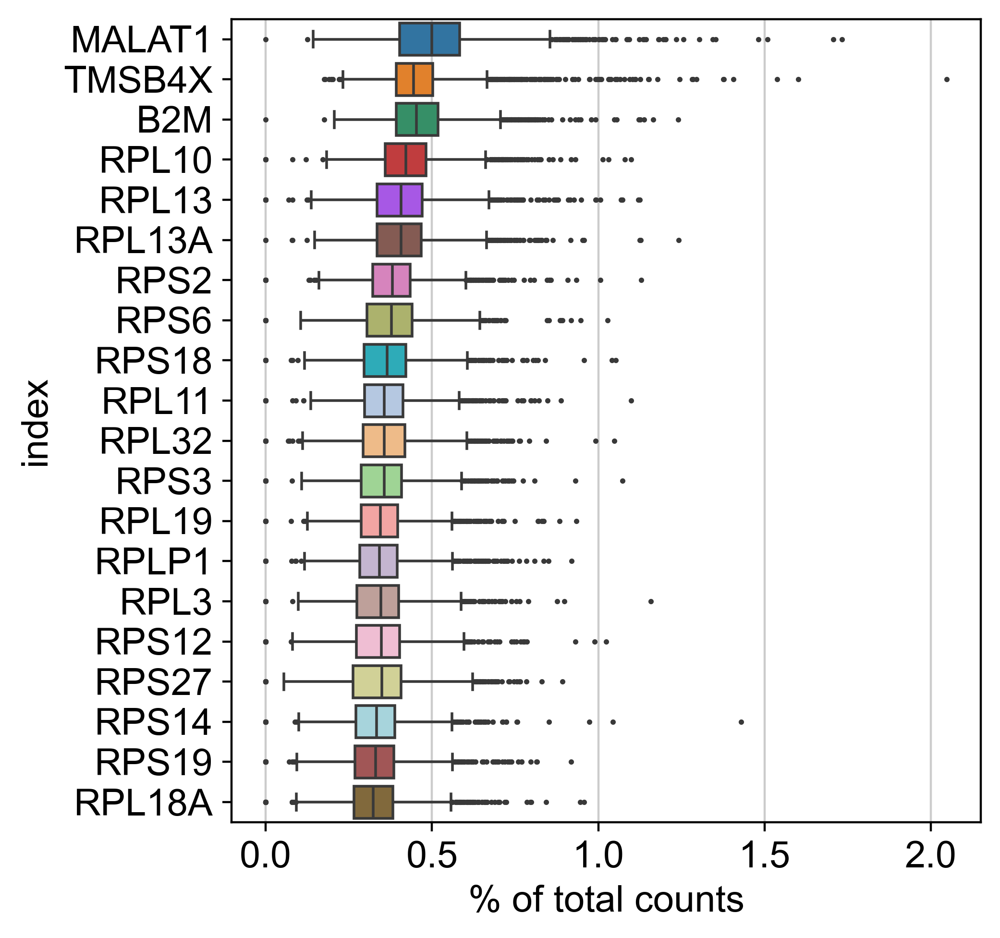

In [9]:
print(adata.shape)
print(adata.raw)

sc.pl.highest_expr_genes(adata, n_top=20)

In [10]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 58 genes that are detected in less than 3 cells


In [11]:
adata.var["mt"] = adata.var_names.str.startswith("MT-")


In [12]:
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

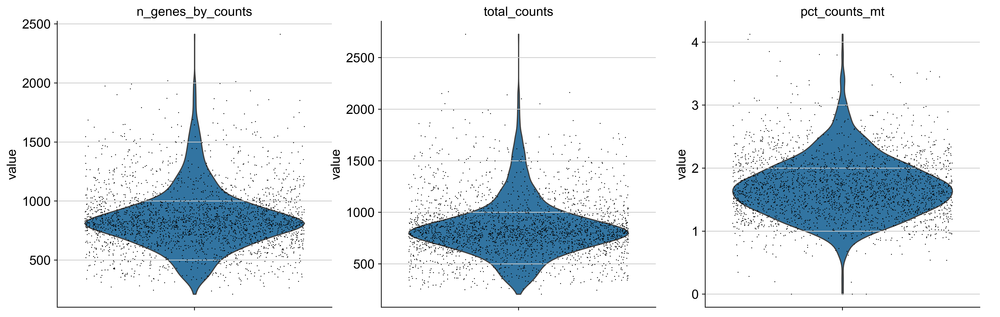

In [13]:
sc.pl.violin(adata, ["n_genes_by_counts", "total_counts", "pct_counts_mt"], jitter=0.4, multi_panel=True)

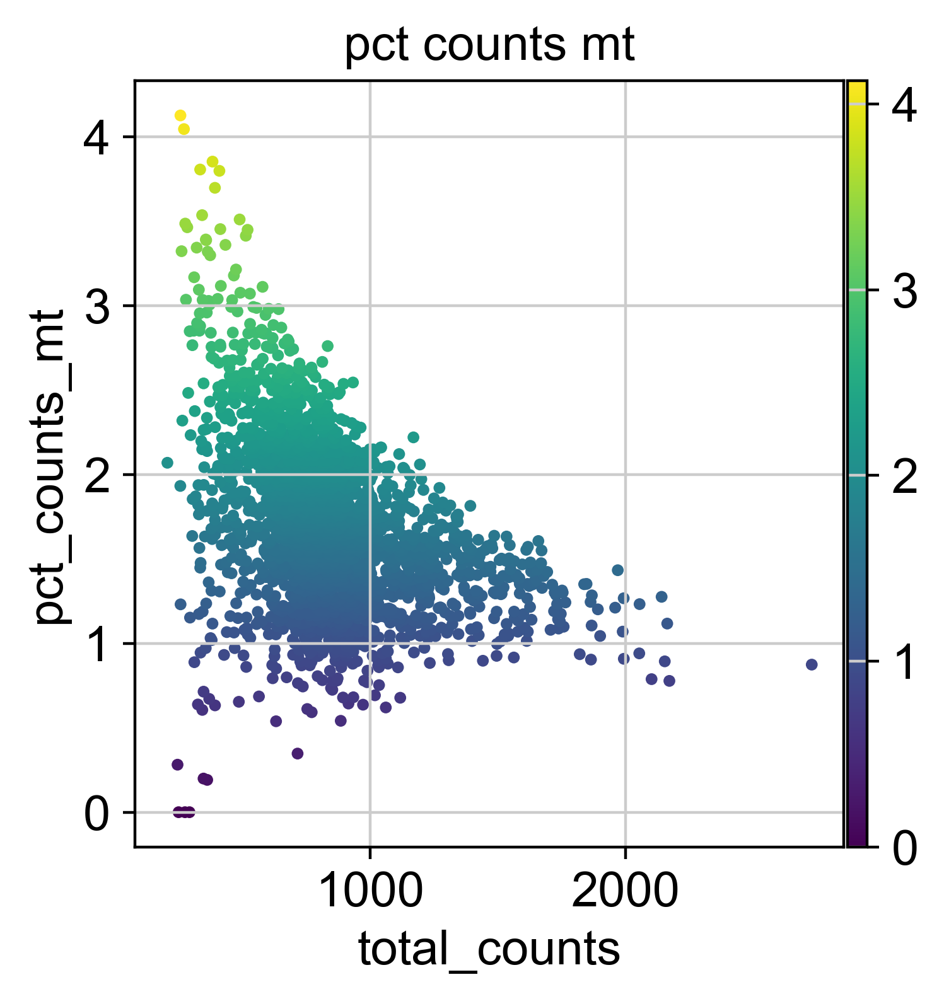

In [14]:
sc.pl.scatter(adata, x="total_counts", y="pct_counts_mt", color="pct_counts_mt")


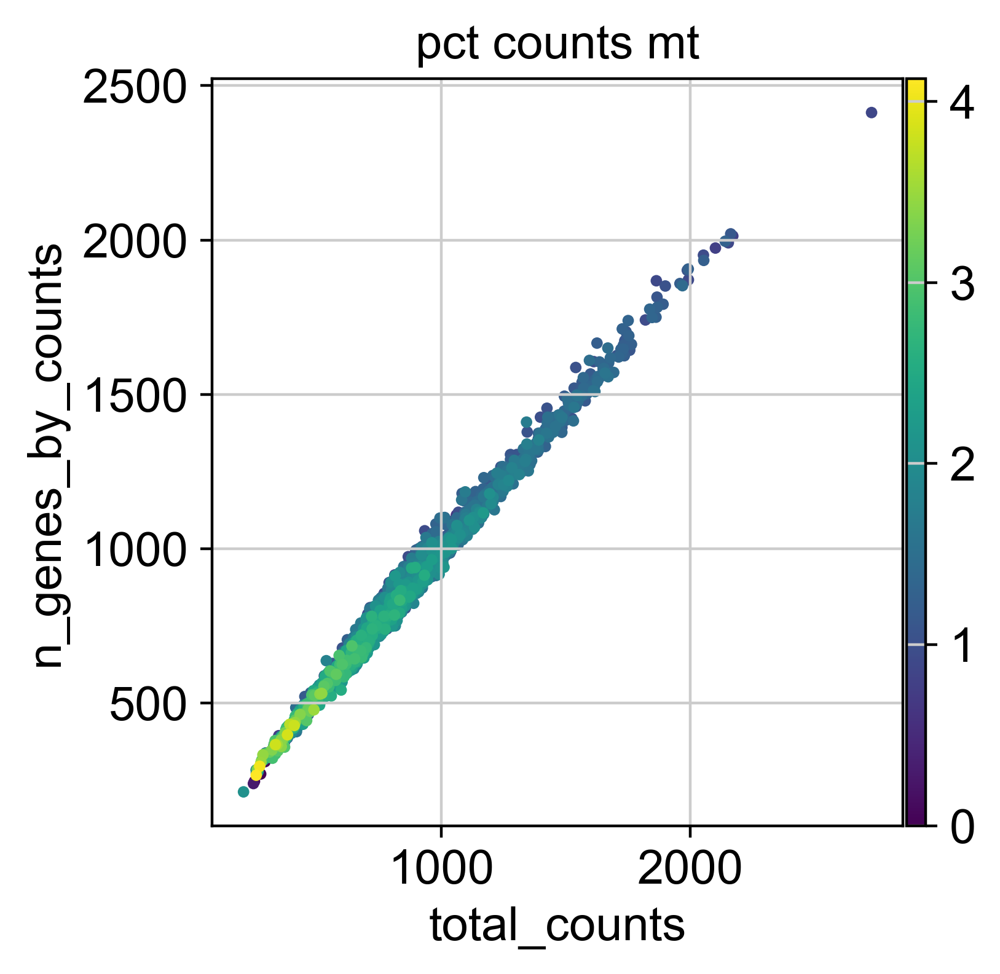

In [15]:
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [16]:
adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt < 5, :].copy()

In [17]:
# Saving count data
adata.layers["counts"] = adata.X.copy()

In [18]:
# Normalizing to median total counts
sc.pp.normalize_total(adata, target_sum=1e4)
# Logarithmize the data:
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


In [19]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


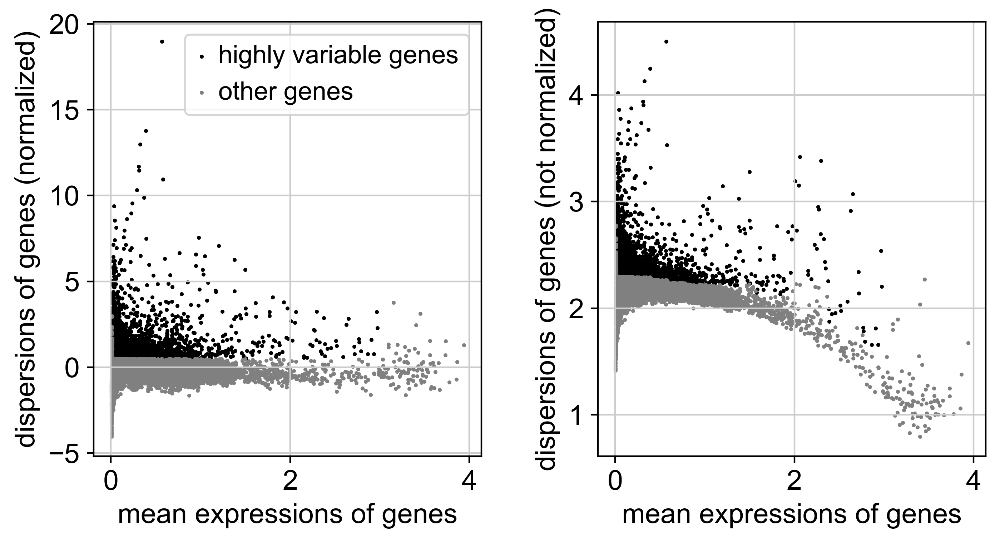

In [20]:
sc.pl.highly_variable_genes(adata)



In [21]:
adata

AnnData object with n_obs × n_vars = 2638 × 13656
    obs: 'n_genes', 'percent_mito', 'n_counts', 'louvain', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'draw_graph', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'log1p', 'hvg'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'X_draw_graph_fr'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [22]:
adata = adata[:, adata.var.highly_variable]

In [23]:
sc.pp.regress_out(adata, ["total_counts", "pct_counts_mt"])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:641: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


    finished (0:00:09)


In [24]:
sc.pp.scale(adata, max_value=10)

In [25]:
sc.tl.pca(adata,svd_solver="arpack")

computing PCA
    with n_comps=50
    finished (0:00:00)


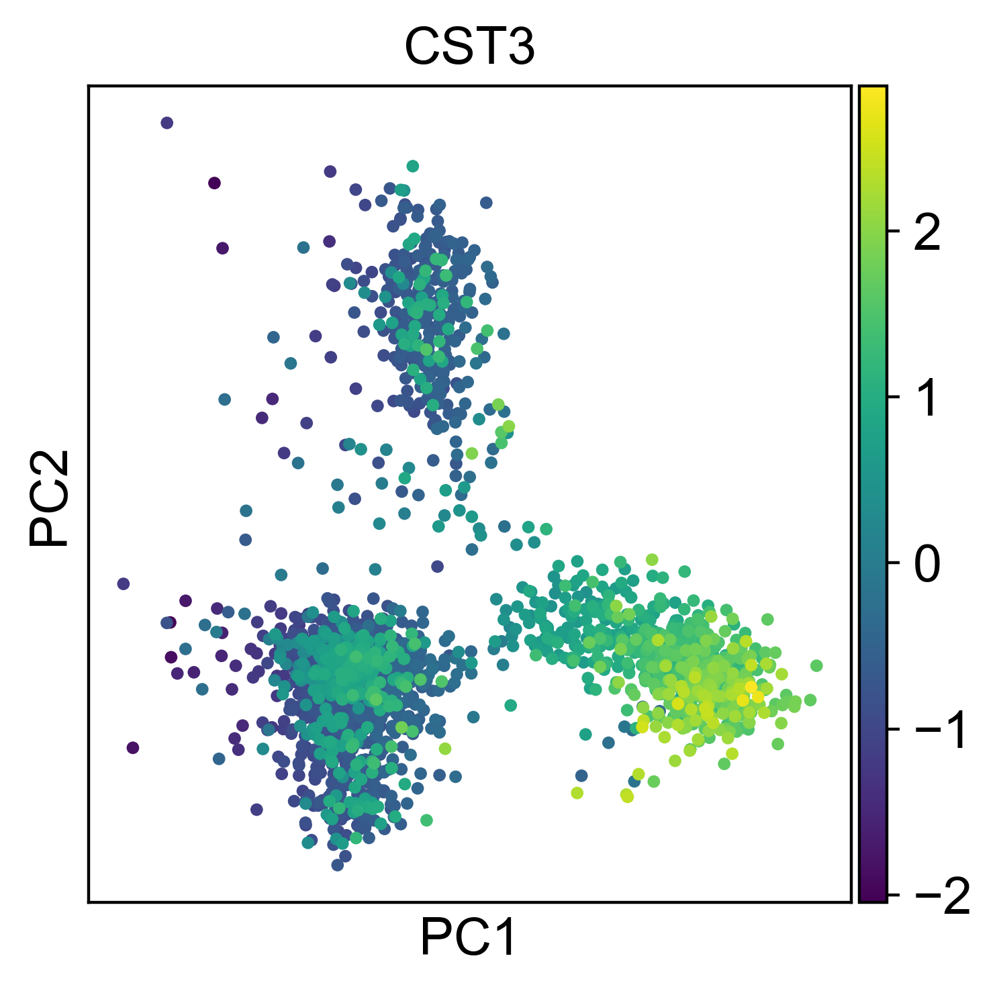

In [26]:
sc.pl.pca(adata, color="CST3")

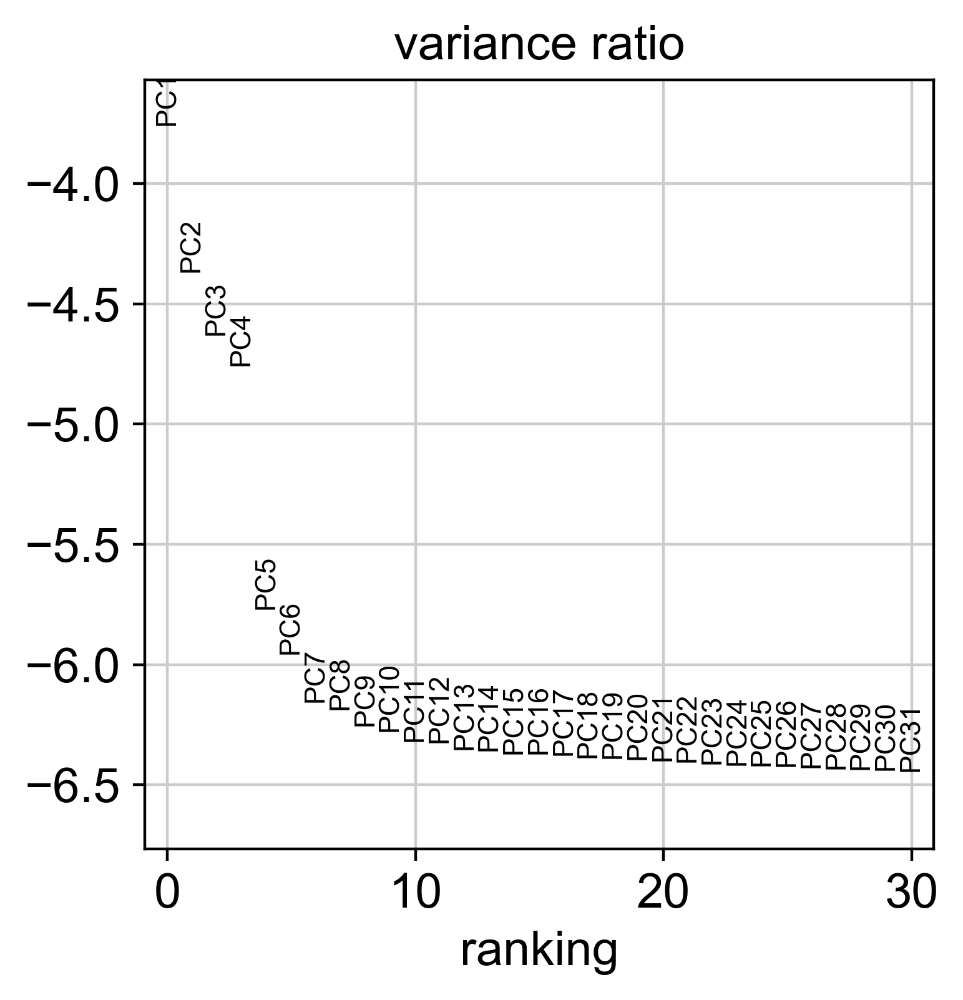

In [27]:
sc.pl.pca_variance_ratio(adata,log=True)

In [28]:
adata.obs

,n_genes,percent_mito,n_counts,louvain,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
index,,,,,,,,
AAACATACAACCAC-1,779,0.030178,2419.0,CD4 T cells,779,802.228088,18.370808,2.289973
AAACATTGAGCTAC-1,1352,0.037936,4903.0,B cells,1352,1391.768799,25.243649,1.813782
AAACATTGATCAGC-1,1129,0.008897,3147.0,CD4 T cells,1129,1122.006470,11.589887,1.032961
AAACCGTGCTTCCG-1,960,0.017431,2639.0,CD14+ Monocytes,960,976.708496,15.905773,1.628508
AAACCGTGTATGCG-1,521,0.012245,980.0,NK cells,521,452.830963,5.257495,1.161028
...,...,...,...,...,...,...,...,...
TTTCGAACTCTCAT-1,1153,0.021104,3459.0,CD14+ Monocytes,1153,1194.914551,12.480518,1.044469
TTTCTACTGAGGCA-1,1224,0.009294,3443.0,B cells,1223,1233.224854,10.892285,0.883236
TTTCTACTTCCTCG-1,622,0.021971,1684.0,B cells,622,634.263733,12.388393,1.953193


In [29]:
sc.pp.neighbors(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


In [30]:
adata.write(results_file)

In [31]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [32]:
sc.tl.umap(adata)



computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


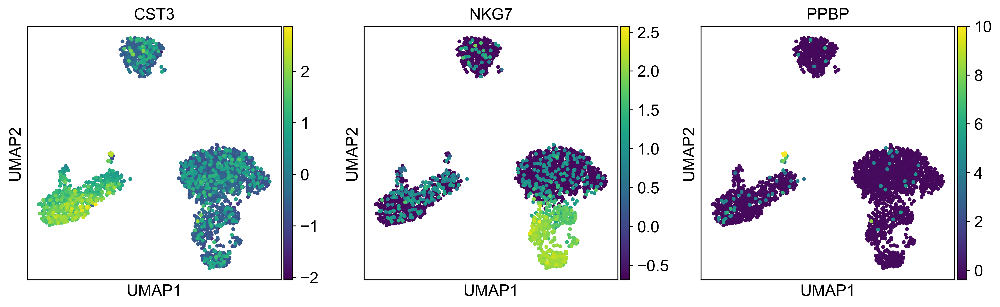

In [33]:
sc.pl.umap(adata, color=["CST3", "NKG7", "PPBP"], use_raw=False)

In [34]:
!pip install leidenalg


  Using cached leidenalg-0.10.2-cp38-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (2.0 MB)
  Using cached igraph-0.11.4-cp39-abi3-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.3 MB)
  Using cached texttable-1.7.0-py2.py3-none-any.whl (10 kB)


In [35]:
sc.tl.leiden(adata,
    resolution=0.9,
    random_state=0,
    flavor="igraph",
    n_iterations=2,
    directed=False)

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


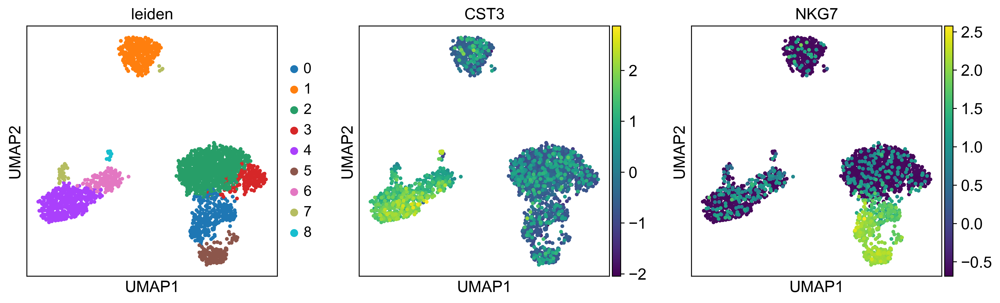

In [36]:
sc.pl.umap(adata, color=["leiden", "CST3", "NKG7"])

In [37]:
adata.write(results_file)

In [38]:
sc.tl.paga(adata)


running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


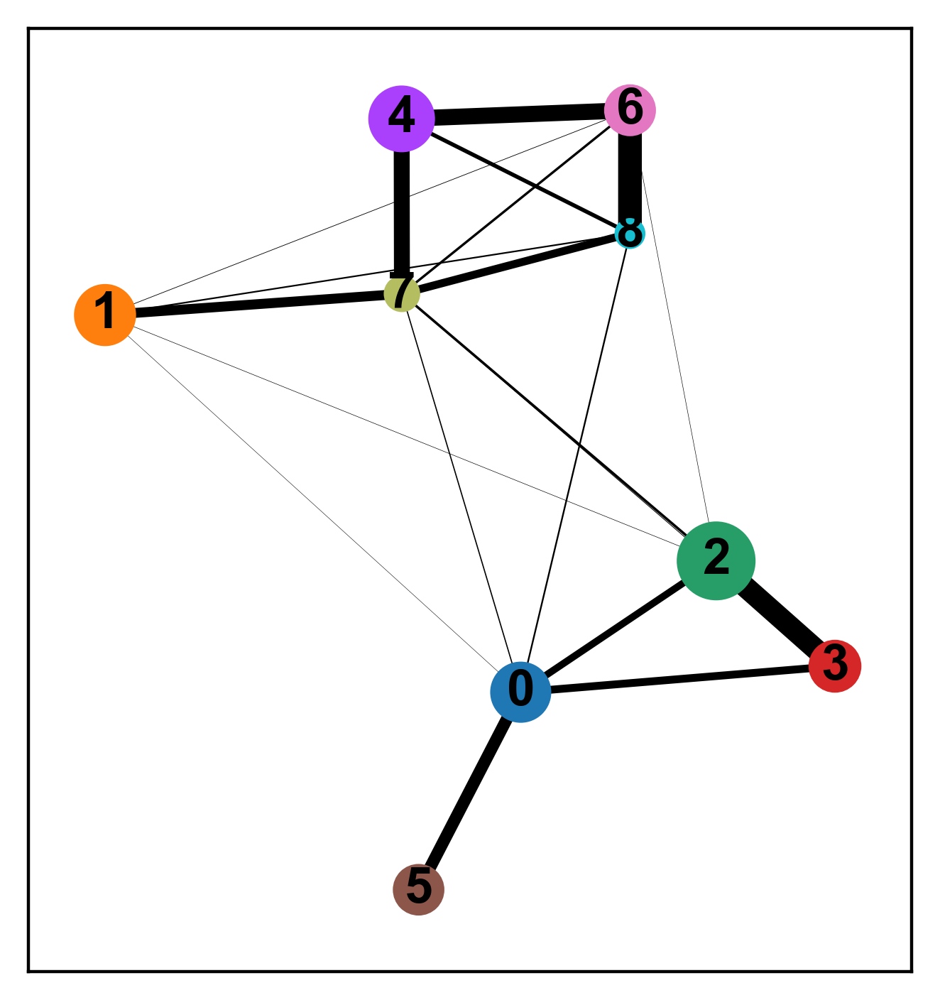

In [39]:
sc.pl.paga(adata, plot=True)

In [40]:
adata.uns

{'draw_graph': {'params': {'layout': 'fr', 'random_state': array([0])}},
 'louvain': {'params': {'random_state': array([0]), 'resolution': array([1])}},
 'louvain_colors': array(['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b',
        '#e377c2', '#bcbd22'], dtype='<U7'),
 'neighbors': {'connectivities_key': 'connectivities',
  'distances_key': 'distances',
  'params': {'n_neighbors': 10,
   'method': 'umap',
   'random_state': 0,
   'metric': 'euclidean',
   'n_pcs': 40}},
 'pca': {'params': {'zero_center': True,
   'use_highly_variable': True,
   'mask_var': 'highly_variable'},
  'variance': array([42.07459139, 22.86725937, 17.56448797, 15.49339332,  5.61603124,
          4.66472323,  3.81560539,  3.70519795,  3.46182683,  3.37782849,
          3.23899734,  3.22204951,  3.13152363,  3.12287102,  3.0804146 ,
          3.07622174,  3.05941211,  3.0336444 ,  3.02473083,  3.00908955,
          2.98900519,  2.980116  ,  2.95070339,  2.93891796,  2.93238683,
          2.91

In [41]:
sc.tl.louvain(
    adata,
    resolution=0.9,
    random_state=0,
    flavor="igraph",
    directed=False,
)

running Louvain clustering
    finished: found 8 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


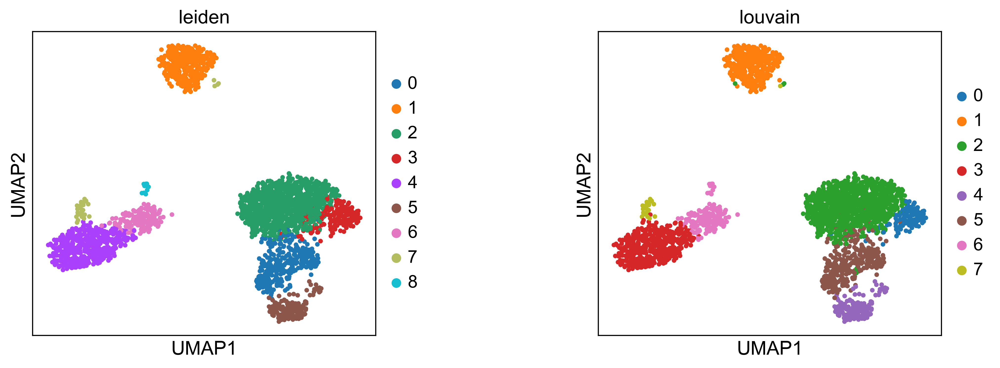

In [42]:
sc.pl.umap(
    adata, color=["leiden", "louvain"], wspace=0.5, ncols=2
)

In [43]:
sc.tl.rank_genes_groups(adata, "leiden", method="t-test")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: 

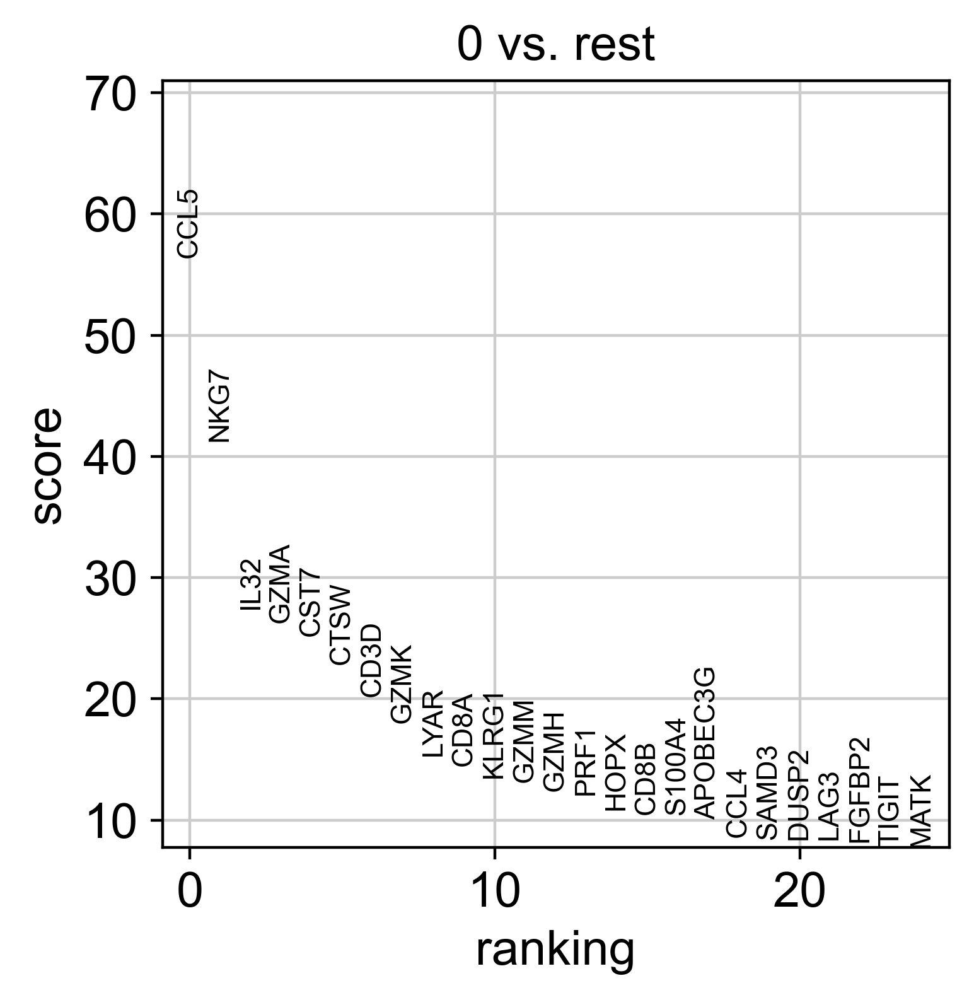

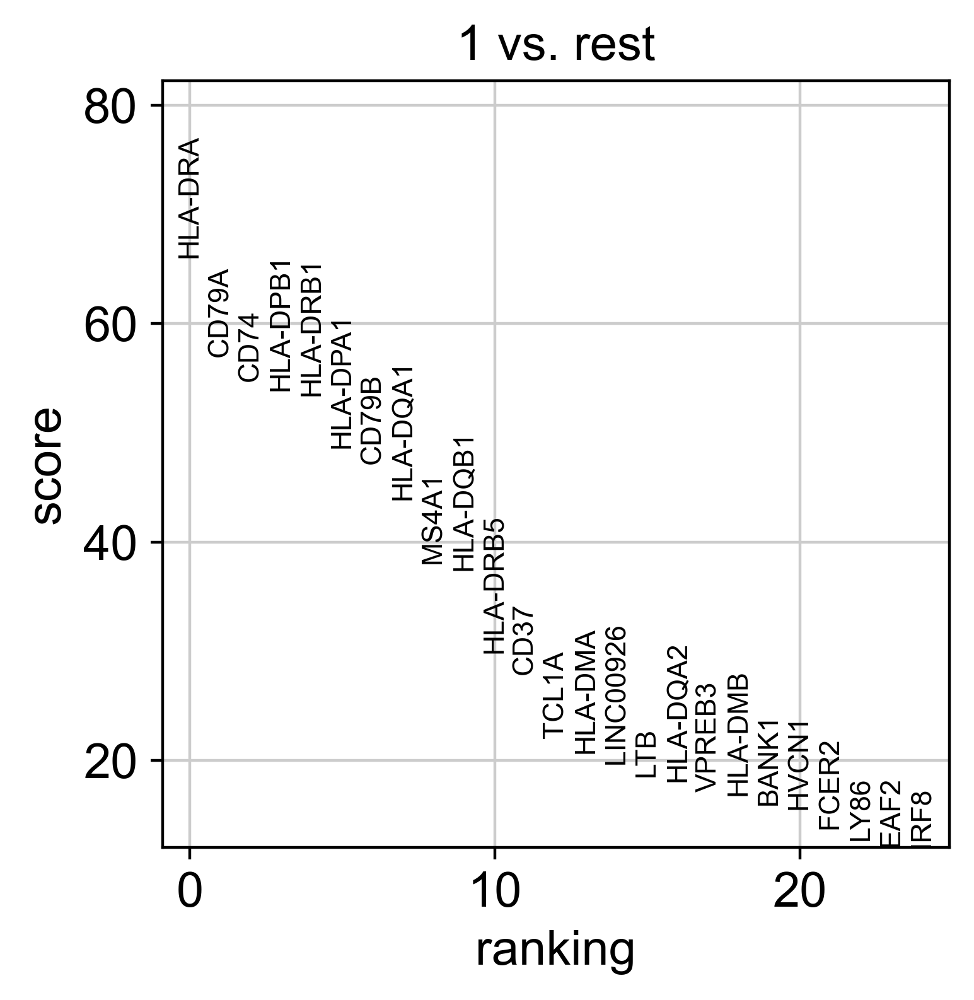

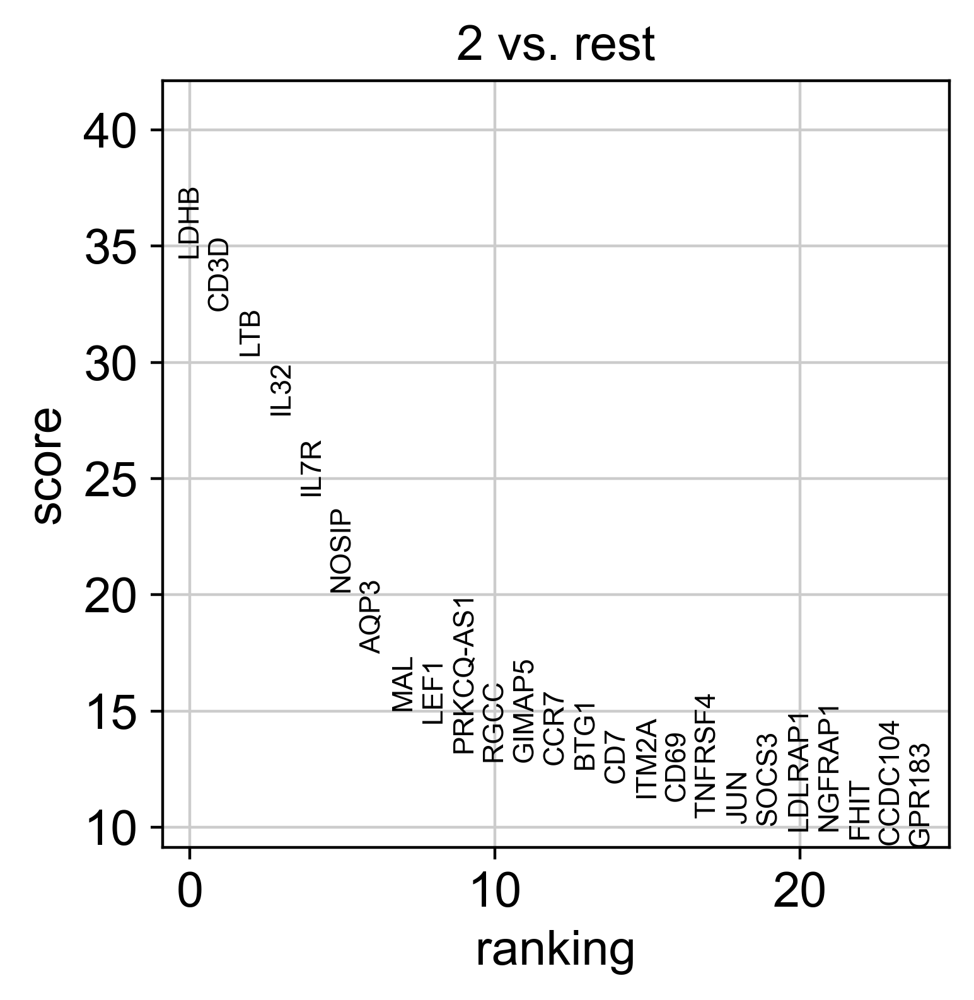

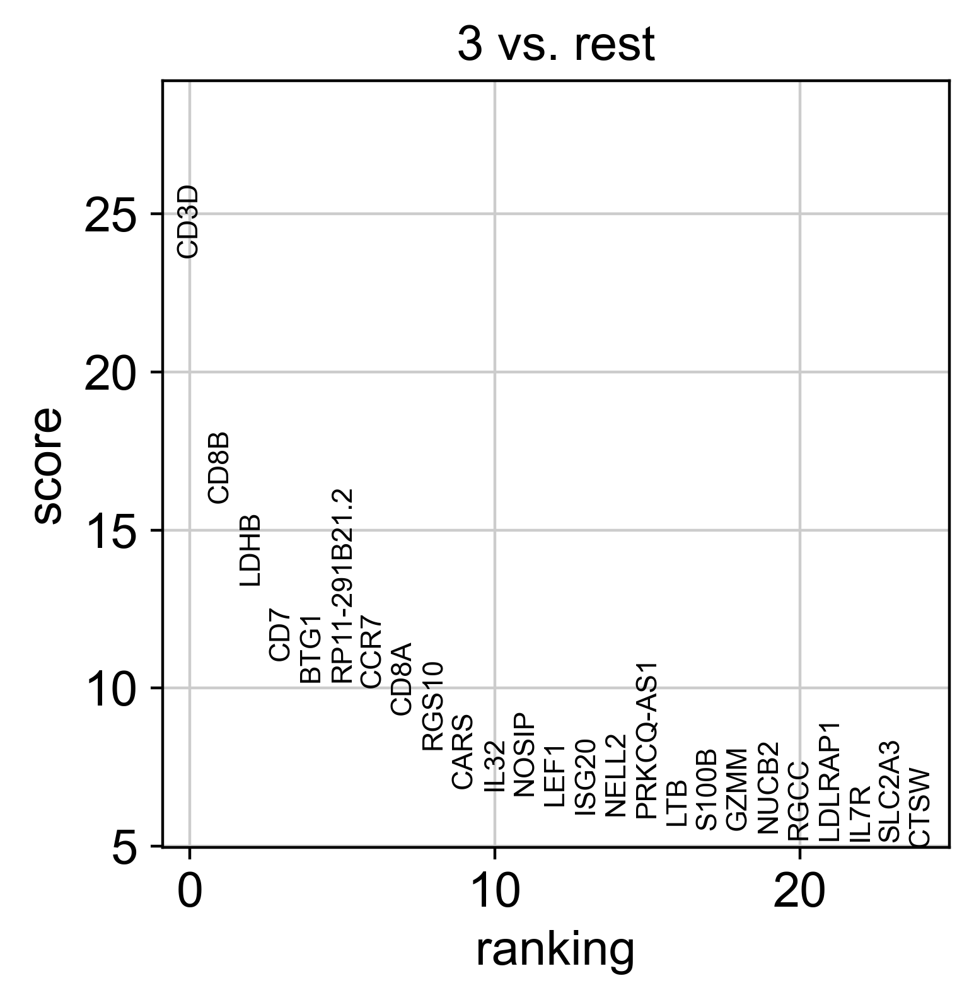

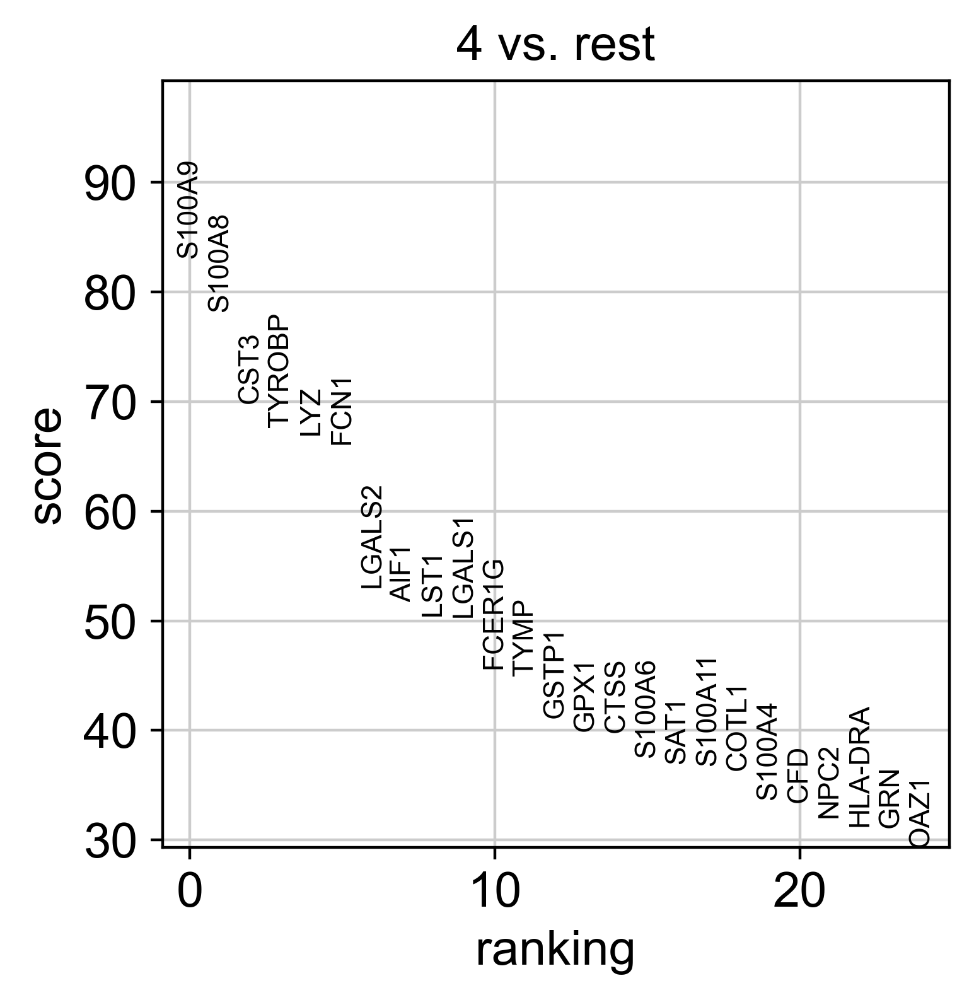

In [44]:
for i in range(5):  
    sc.pl.rank_genes_groups(adata, str(i) ,n_genes=25, sharey=False)

In [45]:
sc.tl.rank_genes_groups(adata, "leiden", method="t-test")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: 

In [46]:
sc.tl.rank_genes_groups(adata, "louvain", method="t-test")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: 

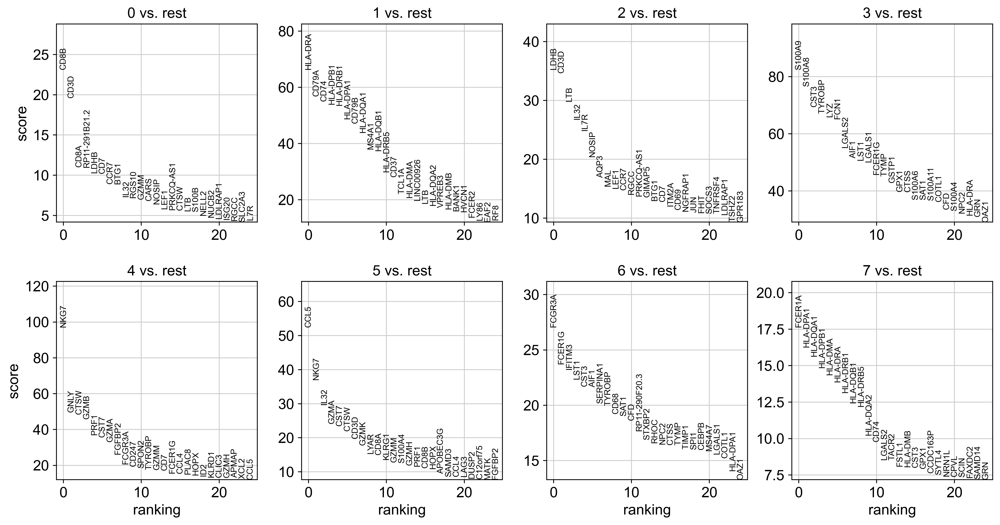

In [47]:
sc.pl.rank_genes_groups(adata ,n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


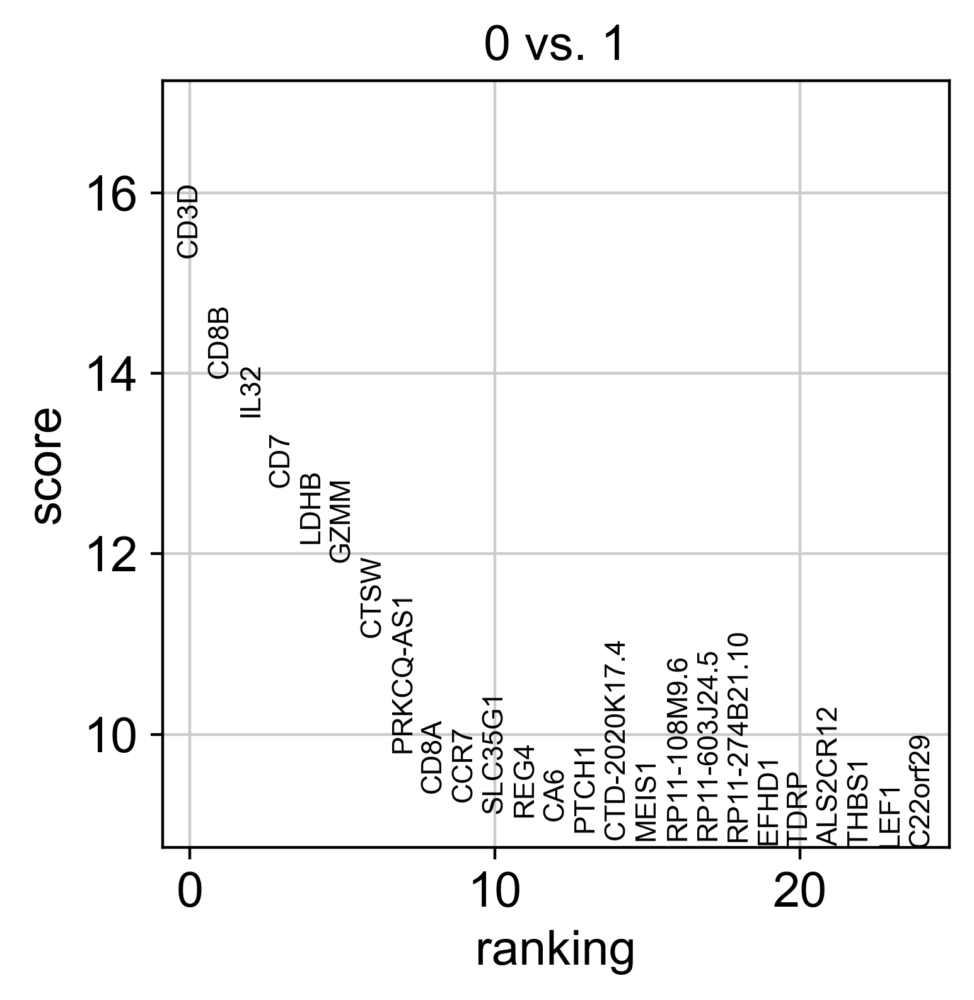

In [48]:
sc.tl.rank_genes_groups(adata, "louvain", method="wilcoxon",groups=["0"], reference="1")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


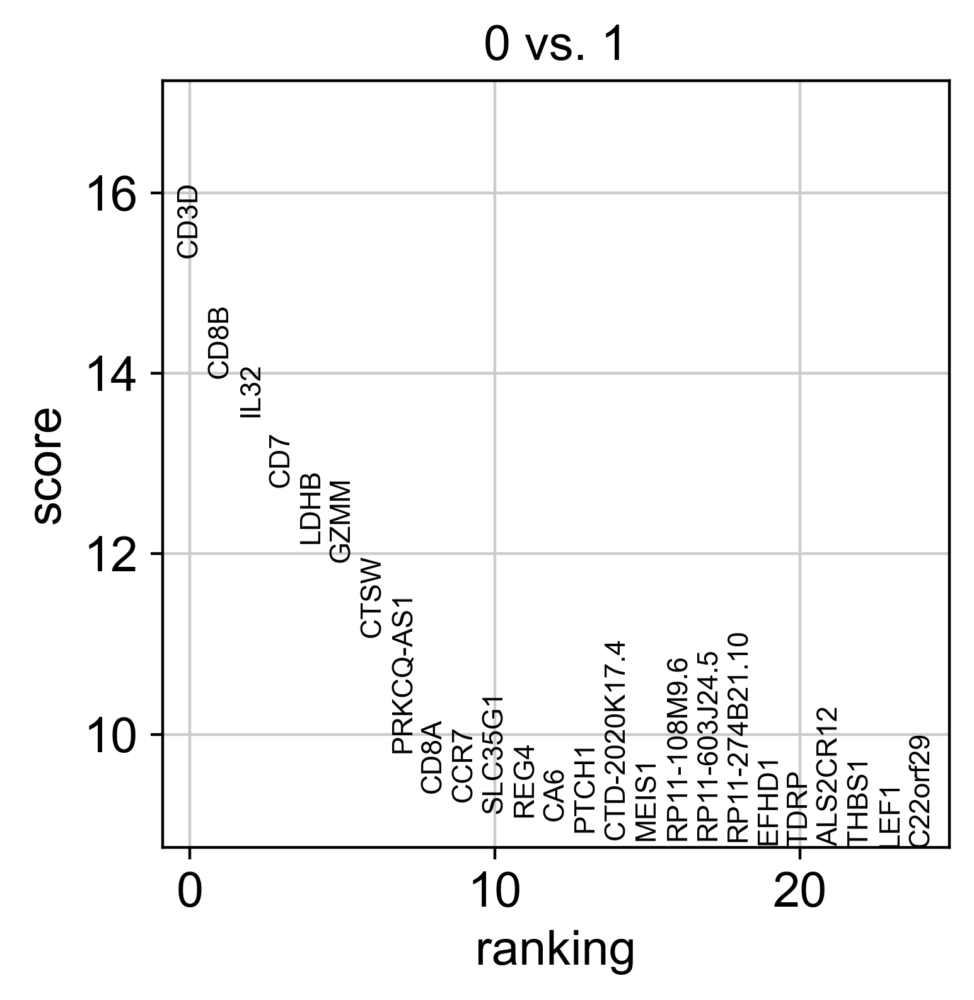

In [49]:
sc.tl.rank_genes_groups(adata, "louvain", method="wilcoxon",groups=["0"], reference="1")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:01)


/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


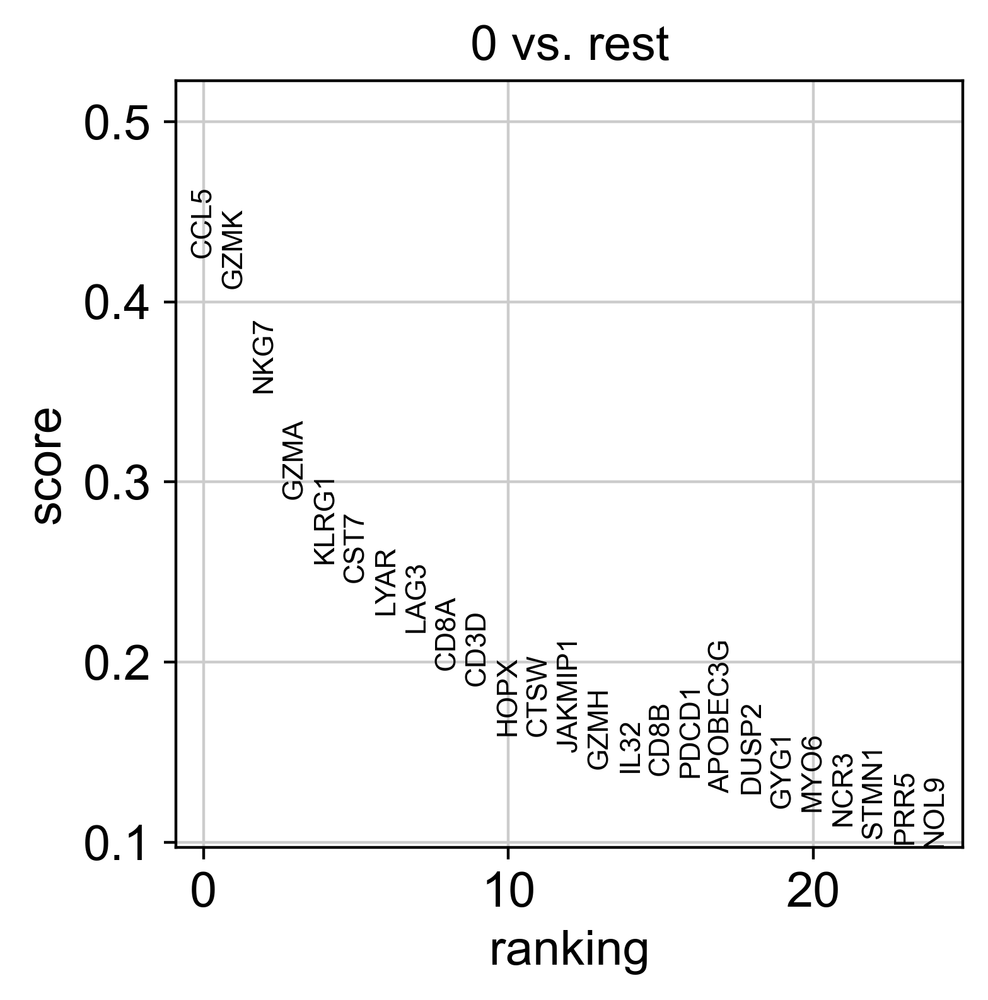

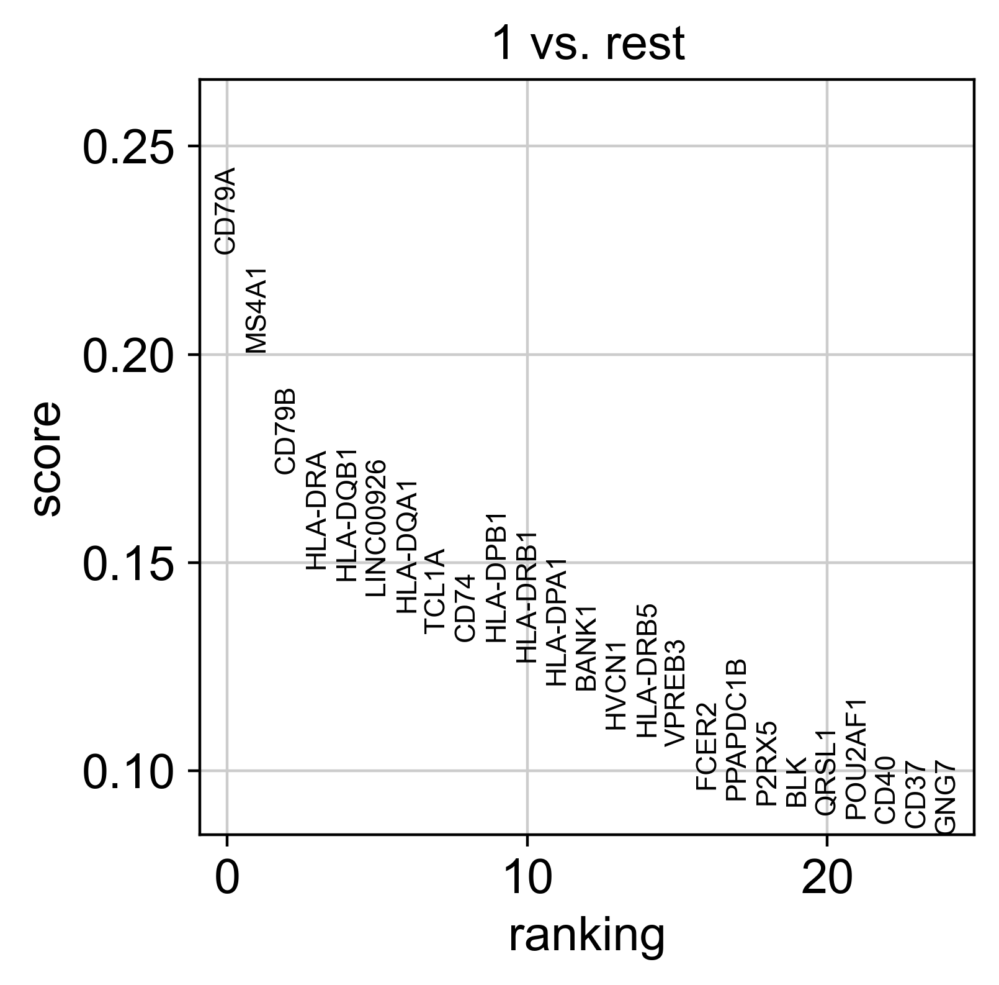

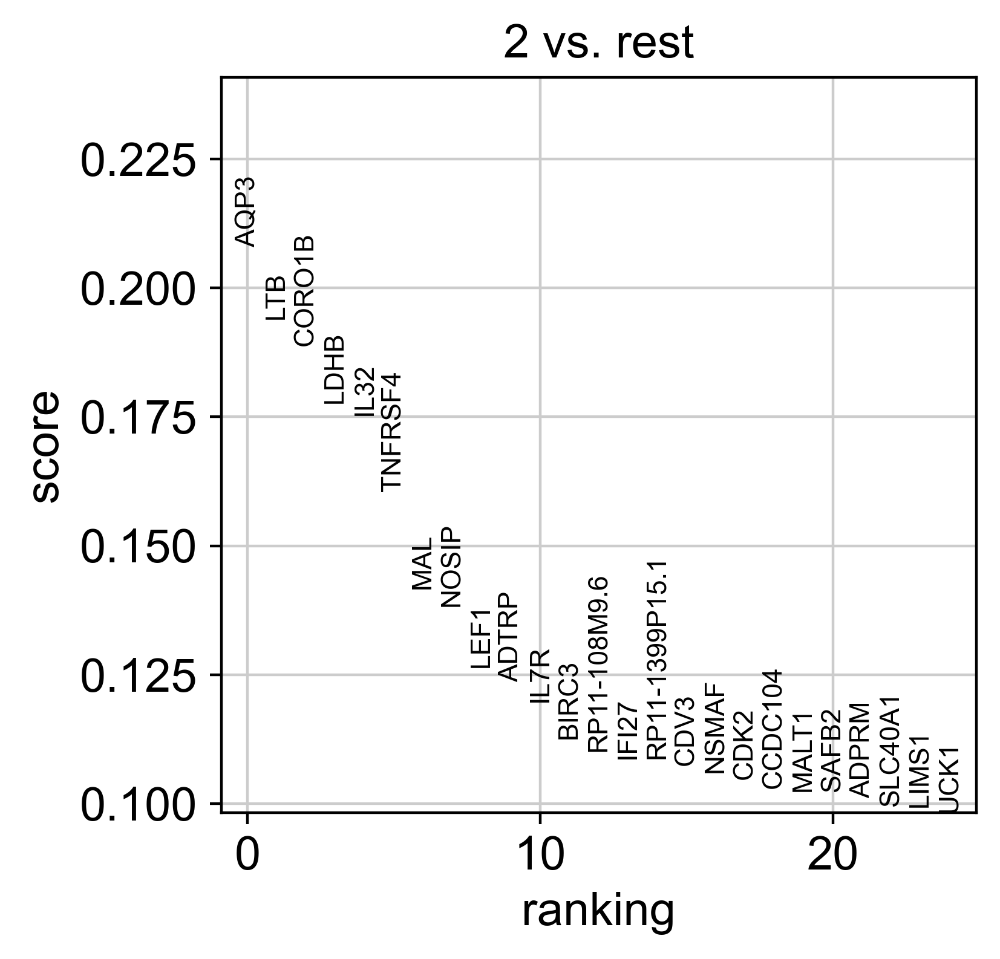

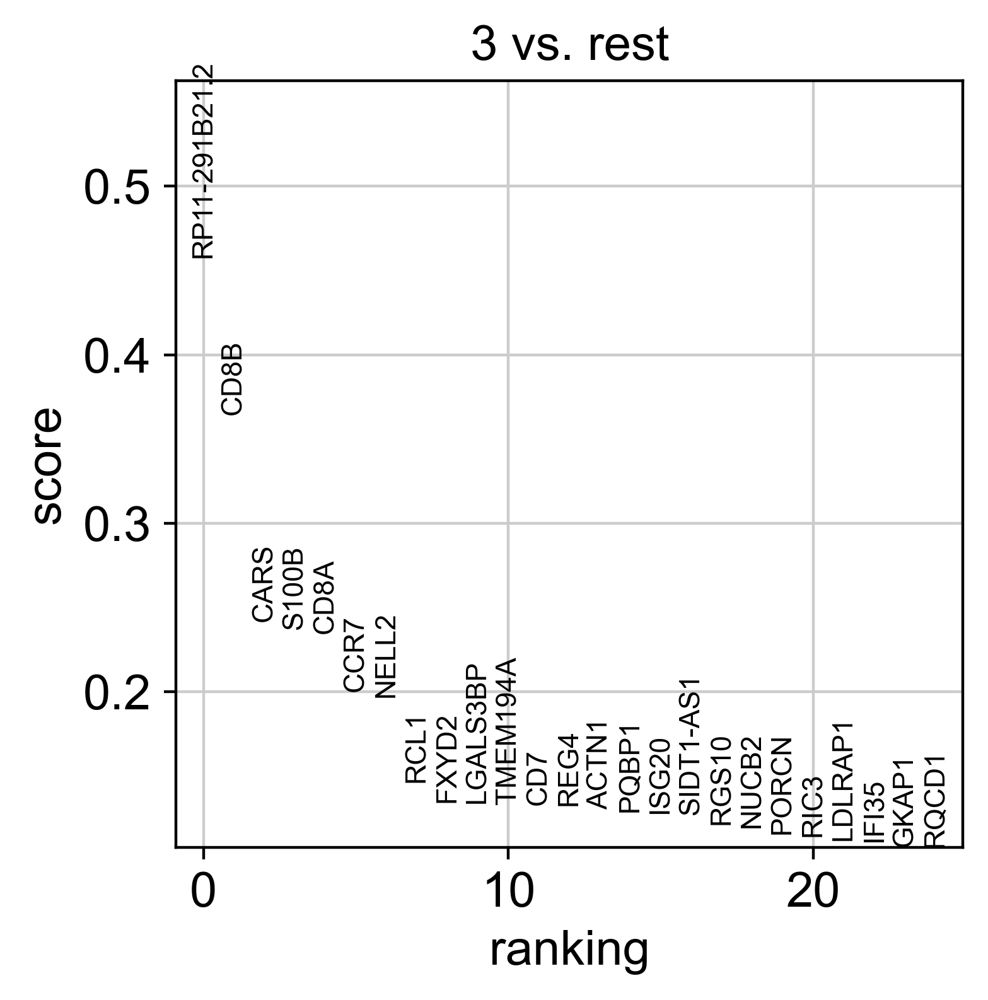

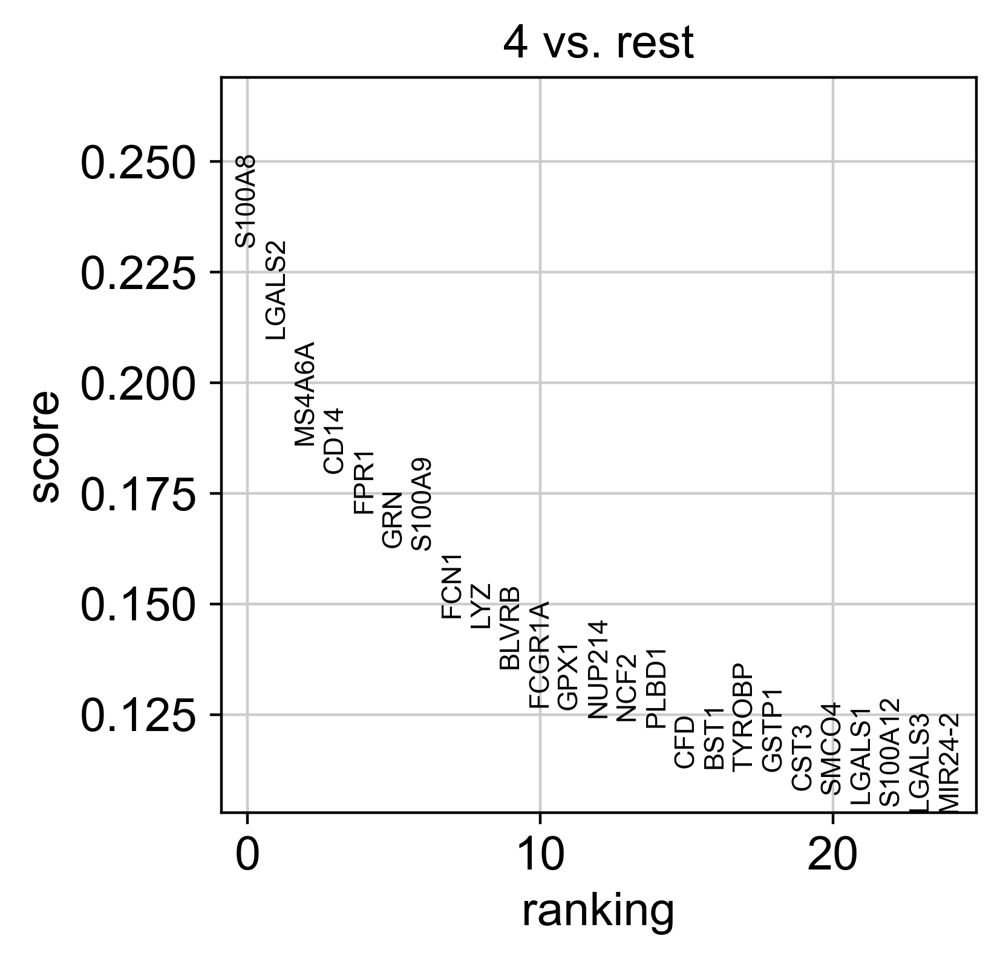

In [50]:
sc.tl.rank_genes_groups(adata, "leiden", method="logreg")
for i in range(5):
    sc.pl.rank_genes_groups(adata, str(i), n_genes=25, sharey=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:00:01)


/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


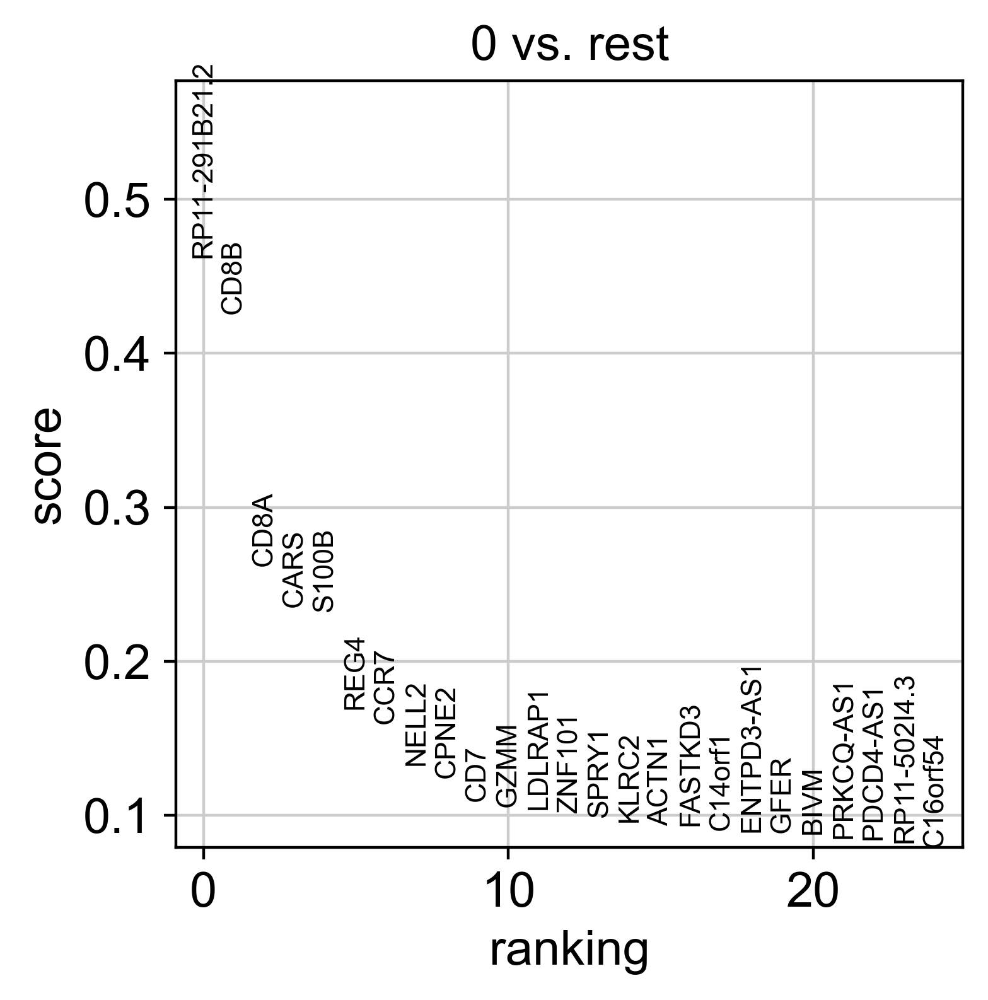

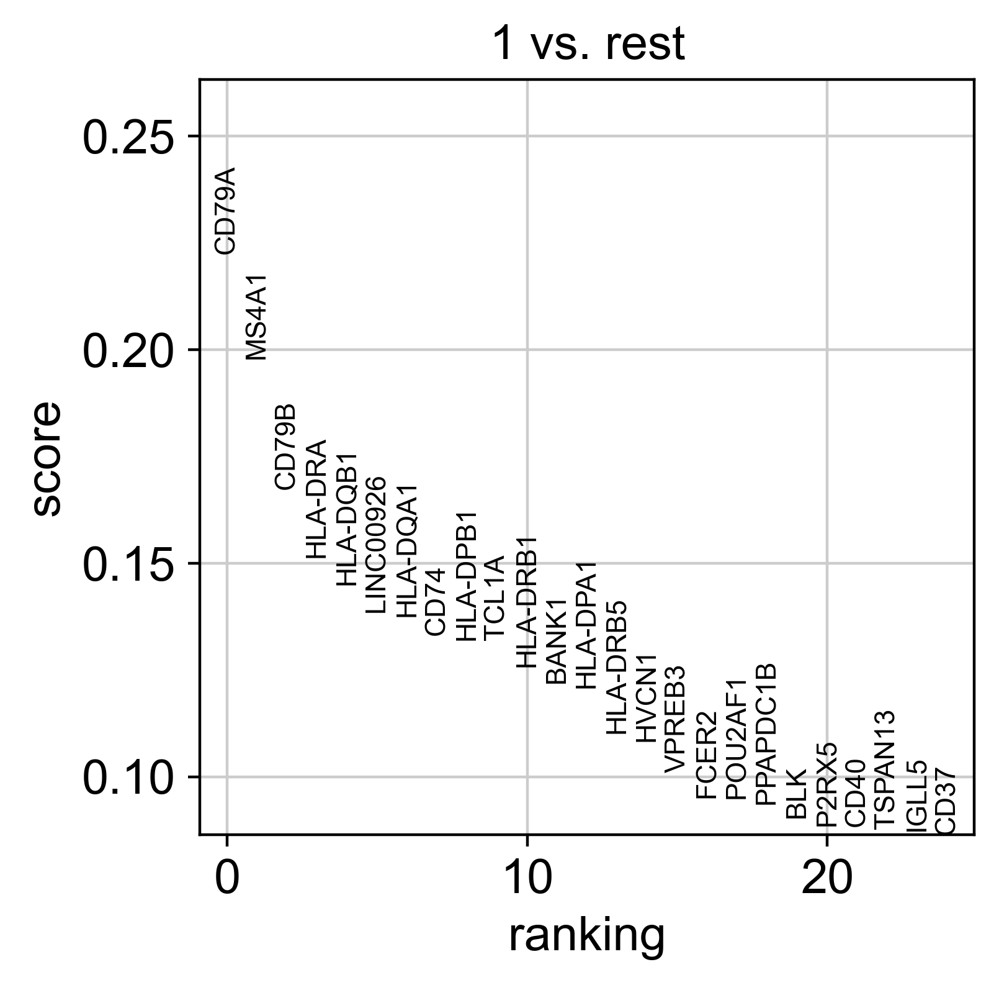

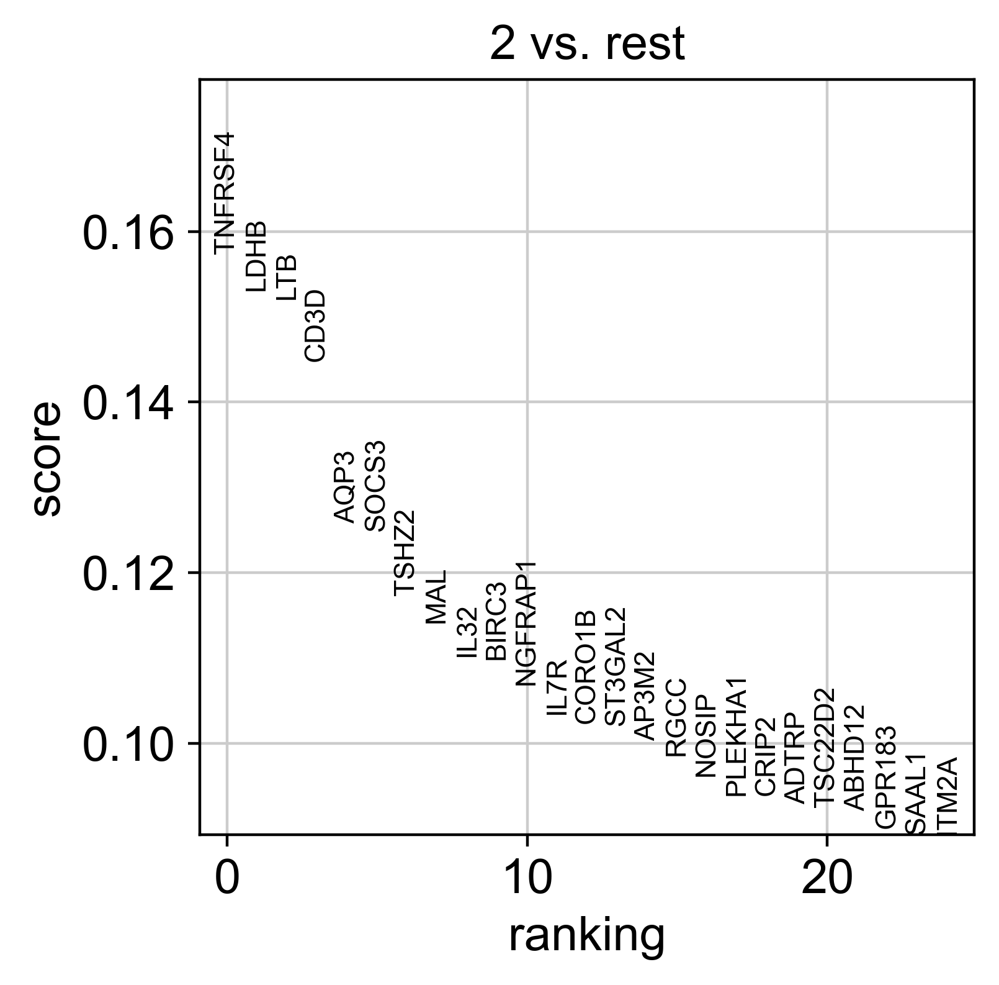

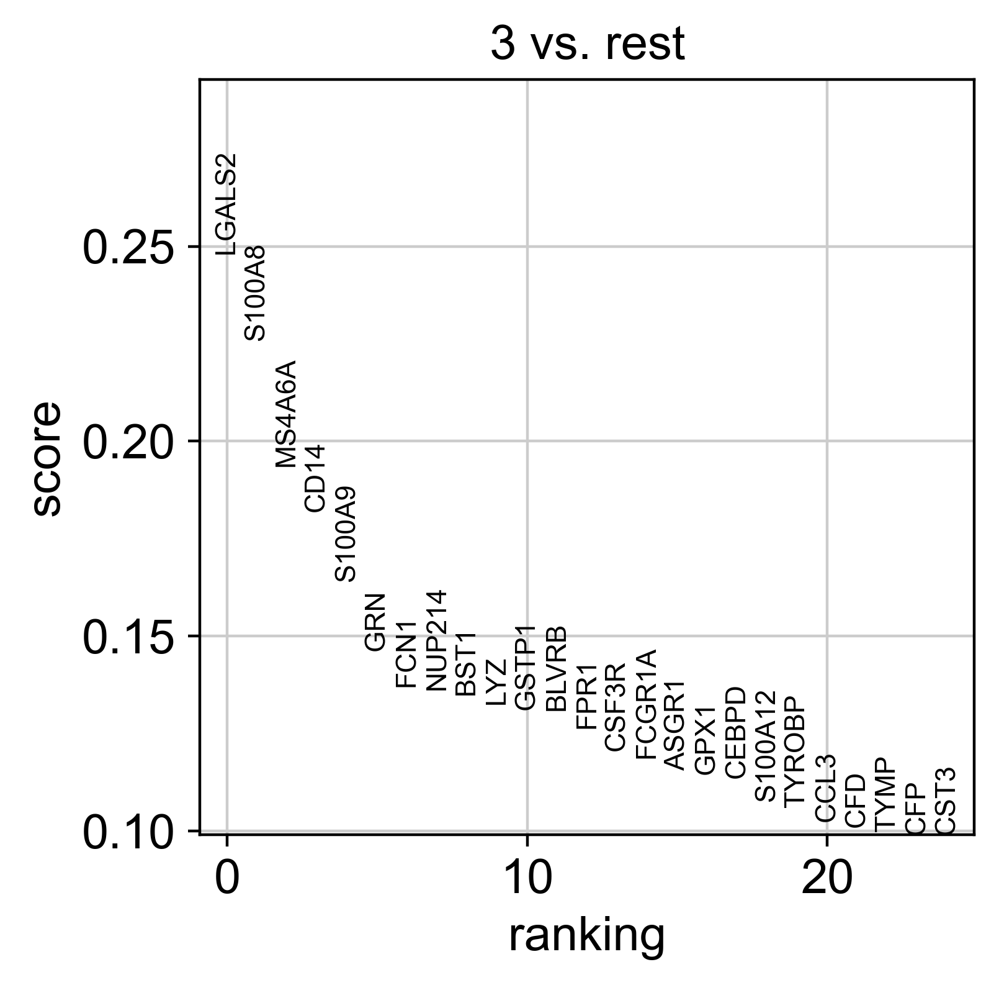

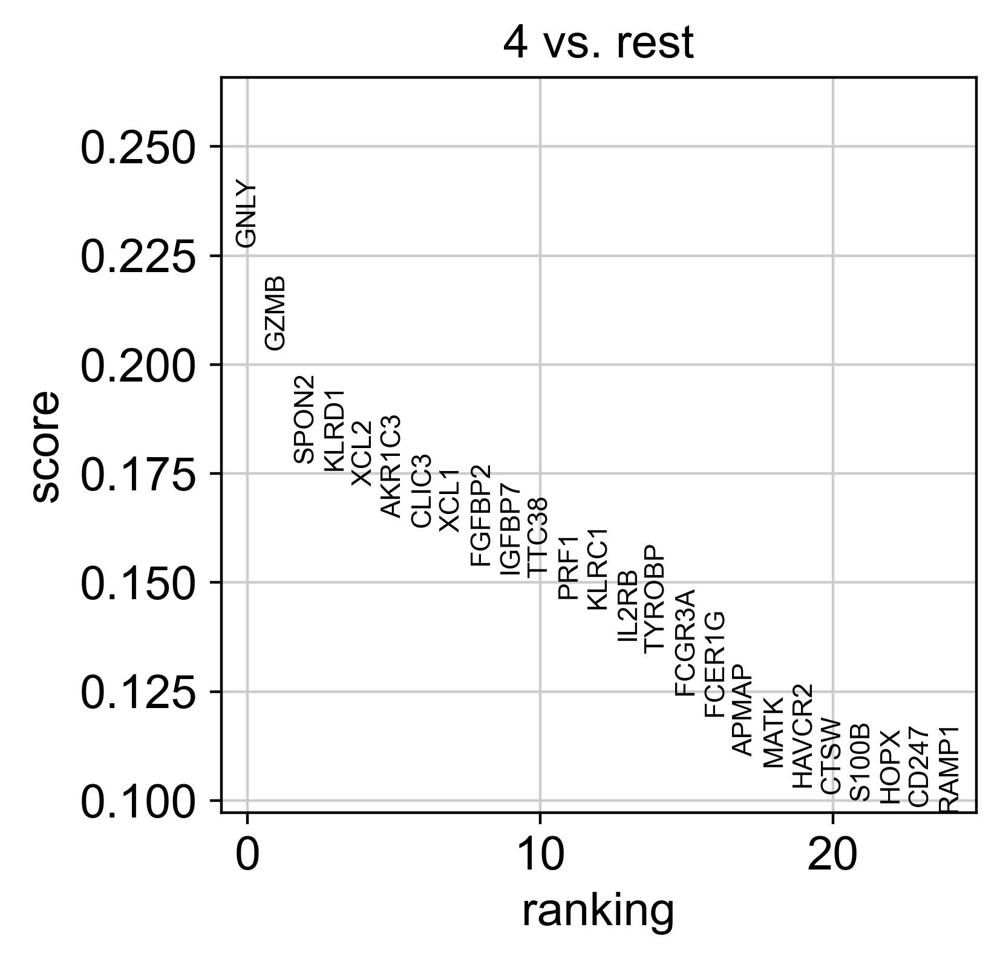

In [51]:
sc.tl.rank_genes_groups(adata, "louvain", method="logreg")
for i in range(5):
    sc.pl.rank_genes_groups(adata, str(i), n_genes=25, sharey=False)

In [52]:
adata.uns['rank_genes_groups']

{'params': {'groupby': 'louvain',
  'reference': 'rest',
  'method': 'logreg',
  'use_raw': False,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('RP11-291B21.2', 'CD79A', 'TNFRSF4', 'LGALS2', 'GNLY', 'CCL5', 'FCGR3A', 'FCER1A'),
            ('CD8B', 'MS4A1', 'LDHB', 'S100A8', 'GZMB', 'GZMK', 'RP11-290F20.3', 'CD1C'),
            ('CD8A', 'CD79B', 'LTB', 'MS4A6A', 'SPON2', 'NKG7', 'MS4A7', 'HLA-DQA2'),
            ...,
            ('S100A11', 'IL32', 'RP11-291B21.2', 'LTB', 'CD8A', 'IGFBP7', 'CD14', 'CDA'),
            ('GZMK', 'CD3D', 'CD8A', 'FCER1A', 'CD8B', 'CCR7', 'MS4A6A', 'RP11-290F20.3'),
            ('ALOX5AP', 'S100A4', 'CD8B', 'FCGR3A', 'CD3D', 'C1orf162', 'LGALS2', 'CFD')],
           dtype=[('0', 'O'), ('1', 'O'), ('2', 'O'), ('3', 'O'), ('4', 'O'), ('5', 'O'), ('6', 'O'), ('7', 'O')]),
 'scores': rec.array([( 0.46211353,  0.22245505,  0.15739219,  0.2480946 ,  0.22694816,  0.4042936 ,  0.30352262,  0.34320417),
            ( 0.42554587,  0.

In [53]:
# Ensure that 'leiden' or your desired grouping variable is present in adata.obs
if 'leiden' not in adata.obs:
    sc.tl.leiden(adata)  # This is just an example, use your own grouping variable

# Now you can run the differential expression analysis
sc.tl.rank_genes_groups(adata, groupby='leiden', method='wilcoxon')

# Check for available groups again
if 'rank_genes_groups' in adata.uns:
    groups = adata.uns['rank_genes_groups']['names'].dtype.names
    print("Differential expression analysis has been run.")
    print("Available groups for differential expression:", groups)
else:
    print("Differential expression analysis failed or results are not stored correctly.")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)
Differential expression analysis has been run.
Available groups for differential expression: ('0', '1', '2', '3', '4', '5', '6', '7', '8')


/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/opt/conda/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: 

In [54]:
if 'rank_genes_groups' in adata.uns:
    groups = adata.uns['rank_genes_groups']['names'].dtype.names
    print("Available groups for differential expression:", groups)
else:
    print("Differential expression analysis has not been run.")

Available groups for differential expression: ('0', '1', '2', '3', '4', '5', '6', '7', '8')


In [55]:
import numpy as np

group_number = '0'  # Replace with the group number of interest
de_results = pd.DataFrame({
    'gene_names': adata.uns['rank_genes_groups']['names'][group_number],
    'logfoldchanges': adata.uns['rank_genes_groups']['logfoldchanges'][group_number],
    'pvals': adata.uns['rank_genes_groups']['pvals'][group_number],
    'pvals_adj': adata.uns['rank_genes_groups']['pvals_adj'][group_number]
})
de_results['-log10pvals_adj'] = -np.log10(de_results['pvals_adj'])
de_results['log2foldchanges'] = np.log2(de_results['logfoldchanges'])

/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log2
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [56]:
import numpy as np
import pandas as pd

group_number = '0'  # Replace with the group number of interest

# Create a DataFrame
de_results = pd.DataFrame({
    'gene_names': adata.uns['rank_genes_groups']['names'][group_number],
    'logfoldchanges': adata.uns['rank_genes_groups']['logfoldchanges'][group_number],
    'pvals': adata.uns['rank_genes_groups']['pvals'][group_number],
    'pvals_adj': adata.uns['rank_genes_groups']['pvals_adj'][group_number]
})

# Replace zeros with a very small number before taking log10
de_results['pvals_adj'] = de_results['pvals_adj'].replace(0, np.finfo(float).eps)

# Calculate the -log10 of adjusted p-values
de_results['-log10pvals_adj'] = -np.log10(de_results['pvals_adj'])

# Replace `inf` values that might have resulted from very small p-values
max_log_value = -np.log10(np.finfo(float).eps)
de_results['-log10pvals_adj'] = de_results['-log10pvals_adj'].replace(np.inf, max_log_value)

# Calculate the log2 fold changes
de_results['log2foldchanges'] = np.log2(de_results['logfoldchanges'])

# Now you can print the DataFrame or proceed with further analysis/visualization
print(de_results)

     gene_names  logfoldchanges          pvals      pvals_adj  \
0          CCL5             NaN  6.488103e-144  1.534436e-140   
1          NKG7             NaN  1.047880e-122  1.239118e-119   
2          CST7             NaN   4.985441e-88   3.930189e-85   
3          GZMA             NaN   3.714548e-74   2.196226e-71   
4          CTSW             NaN   2.314078e-70   1.094559e-67   
...         ...             ...            ...            ...   
2360       CTSS             NaN   2.630273e-21   2.591915e-19   
2361      MS4A1             NaN   4.890258e-22   5.257028e-20   
2362       AIF1             NaN   1.610630e-22   1.904570e-20   
2363    HLA-DRA             NaN   8.954771e-26   1.323627e-23   
2364      CD79A             NaN   5.412979e-26   8.534464e-24   

      -log10pvals_adj  log2foldchanges  
0          139.814051              NaN  
1          118.906888              NaN  
2           84.405587              NaN  
3           70.658323              NaN  
4           66

/opt/conda/lib/python3.10/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log2
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [57]:
adata.uns['rank_genes_groups']

{'params': {'groupby': 'leiden',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': False,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('CCL5', 'CD74', 'LDHB', 'CD8B', 'S100A9', 'NKG7', 'FCGR3A', 'ZNF574', 'PPBP'),
            ('NKG7', 'HLA-DRA', 'LTB', 'CD3D', 'LYZ', 'GNLY', 'RP11-159H10.3', 'RP11-420A6.2', 'ILK'),
            ('CST7', 'HLA-DQA1', 'CD3D', 'LDHB', 'S100A8', 'GZMB', 'RP11-643M14.1', 'SLC14A2', 'ABCC3'),
            ...,
            ('AIF1', 'IL32', 'HLA-DRA', 'CYBA', 'CD3D', 'CD3D', 'AC113189.5', 'GOSR2', 'CD3D'),
            ('HLA-DRA', 'S100A4', 'CD74', 'S100A11', 'IL32', 'COTL1', 'CLEC4E', 'VSTM1', 'LTB'),
            ('CD79A', 'CD3D', 'HLA-DRB1', 'HLA-DRB1', 'LTB', 'LTB', 'FCER1A', 'CDA', 'BTG1')],
           dtype=[('0', 'O'), ('1', 'O'), ('2', 'O'), ('3', 'O'), ('4', 'O'), ('5', 'O'), ('6', 'O'), ('7', 'O'), ('8', 'O')]),
 'scores': rec.array([( 25.543476,  28.693123,  28.321285,  13.479356,  33.193844,  19.870878 ,  16.6

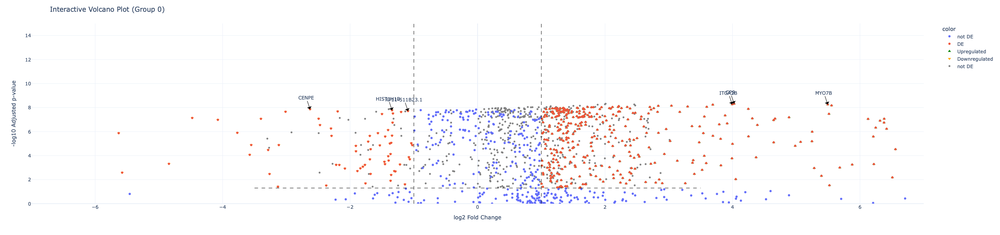

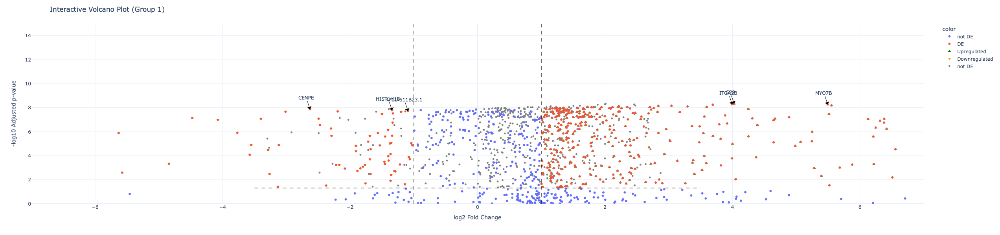

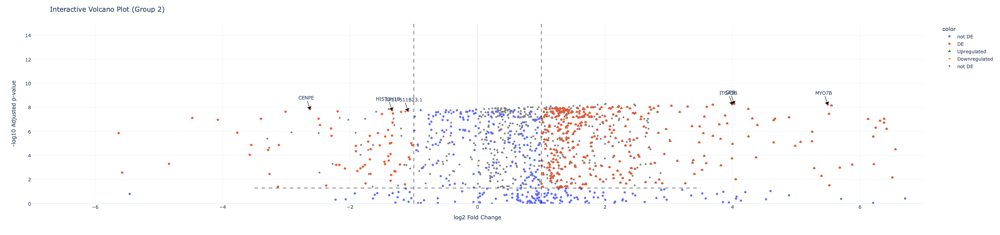

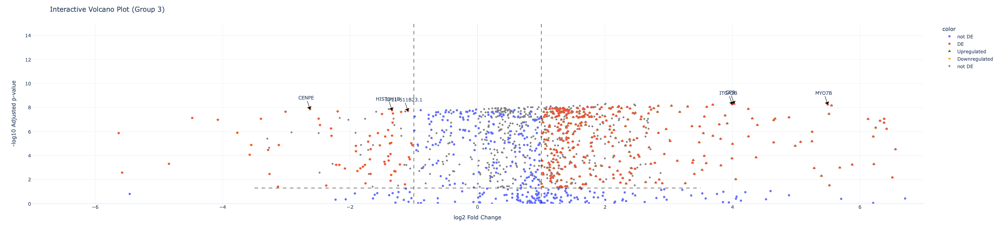

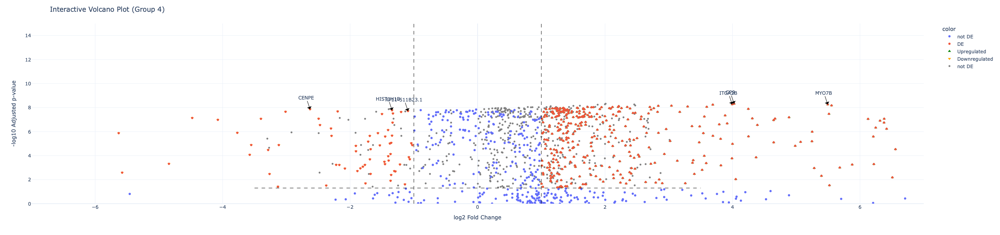

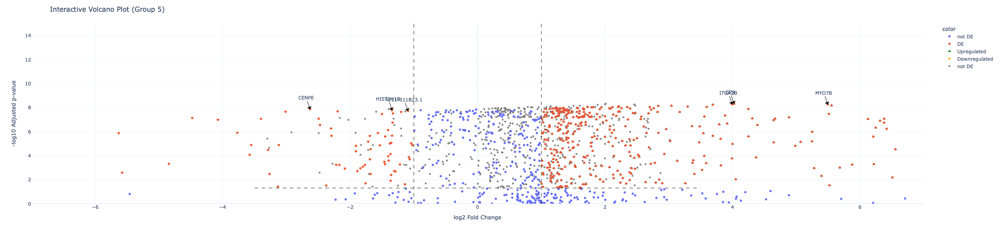

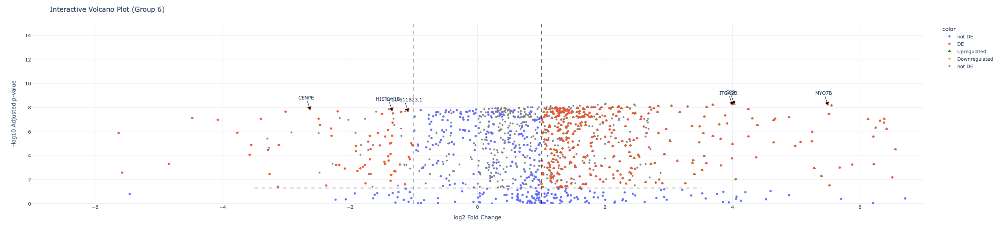

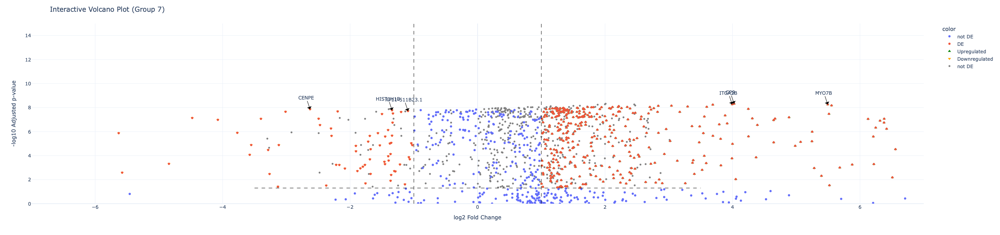

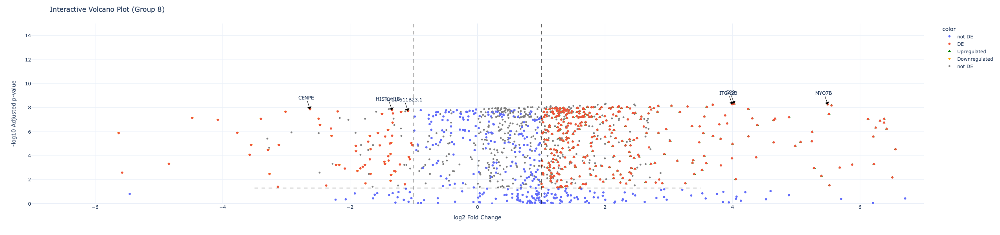

In [112]:
import plotly.express as px
import plotly.graph_objs as go

def create_i_volcano_plot(adata, group, pval_cutoff=0.05, log2fc_cutoff=1, top_n=3):
    
    # Get top significant genes
    sig_genes = de_results[(de_results['pvals_adj'] < pval_cutoff) & (de_results['logfoldchanges'].abs() >= log2fc_cutoff)]
    sig_upregulated = de_results[(de_results['pvals_adj'] < pval_cutoff) & (de_results['logfoldchanges'] > log2fc_cutoff)]
    sig_downregulated = de_results[(de_results['pvals_adj'] < pval_cutoff) & (de_results['logfoldchanges'] < -log2fc_cutoff)]
    top_up_genes = sig_upregulated.nlargest(top_n, '-log10pvals_adj')
    top_down_genes = sig_downregulated.nlargest(top_n, '-log10pvals_adj')
    # Create the interactive volcano plot
    fig = px.scatter(
        de_results, 
        x='logfoldchanges', 
        y=-np.log10(de_results['pvals_adj']),
        color=np.where((de_results['pvals_adj'] < pval_cutoff) & (de_results['logfoldchanges'].abs() >= log2fc_cutoff), 'DE', 'not DE'),
        hover_data=['gene_names']
    )
    
  
    # Add horizontal line for p-value cutoff
    fig.add_shape(
        type='line',
        line=dict(dash='dash', color='black', width=1),
        x0=-max(de_results['logfoldchanges']), x1=max(de_results['logfoldchanges']),
        y0=-np.log10(pval_cutoff), y1=-np.log10(pval_cutoff)
    )

    # Add vertical lines for log2fc cutoffs
    fig.add_shape(
        type='line',
        line=dict(dash='dash', color='black', width=1),
        x0=-log2fc_cutoff, x1=-log2fc_cutoff,
        y0=0, y1=max(de_results['-log10pvals_adj'])
    )
    fig.add_shape(
        type='line',
        line=dict(dash='dash', color='black', width=1),
        x0=log2fc_cutoff, x1=log2fc_cutoff,
        y0=0, y1=max(de_results['-log10pvals_adj'])
    )


    # Add upregulated genes
    fig.add_trace(go.Scatter(
        x=sig_upregulated['logfoldchanges'],
        y=-np.log10(sig_upregulated['pvals_adj']),
        mode='markers',
        marker=dict(color='green', size=7, symbol='triangle-up'),
        name='Upregulated',
        text=sig_upregulated['gene_names'],
        hoverinfo='text'
    ))

    # Add downregulated genes
    fig.add_trace(go.Scatter(
        x=sig_downregulated['logfoldchanges'],
        y=-np.log10(sig_downregulated['pvals_adj']),
        mode='markers',
        marker=dict(color='orange',symbol='triangle-down', size=7),
        name='Downregulated',
        text=sig_downregulated['gene_names'],
        hoverinfo='text'
    ))

    fig.add_trace(go.Scatter(
        
        x=sig_genes['log2foldchanges'],
        y=-np.log10(sig_genes['pvals_adj']),
        mode='markers',
        name='not DE',
        marker=dict(color='grey', size=5),
        text=de_results['gene_names'],
        hoverinfo='text'
    ))
    
    # Set layout properties
    fig.update_layout(
        title=f'Interactive Volcano Plot (Group {group})',
        xaxis_title='log2 Fold Change',
        yaxis_title='-log10 Adjusted p-value',
        template='plotly_white', width=1000,  # Set the width of the plot
        height=600,  # Set the height of the plot
        xaxis=dict(range=[-7, 7]),
        yaxis=dict(range=[0, 15])
    )

    

    for i, row in top_up_genes.iterrows():
        fig.add_annotation(
            x=row['logfoldchanges'],
            y=row['-log10pvals_adj'],
            text=row['gene_names'],
            showarrow=True,
            arrowhead=1,
            arrowsize=2,
            arrowwidth=1,
            arrowcolor='black'
        )   
        
    for i, row in top_down_genes.iterrows():
        fig.add_annotation(
            x=row['logfoldchanges'],
            y=row['-log10pvals_adj'],
            text=row['gene_names'],
            showarrow=True,
            arrowhead=1,
            arrowsize=2,
            arrowwidth=1,
            arrowcolor='black'
        )
    
    # Show figure
    fig.show()

# Example usage:
for i in range(len(groups)):
    create_i_volcano_plot(adata, str(groups[i]))


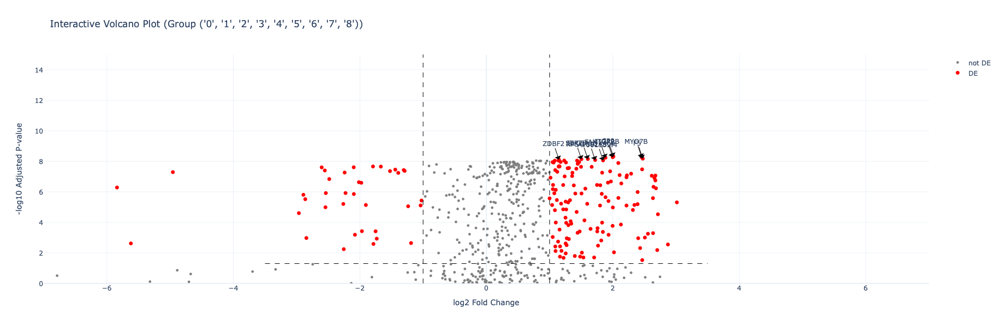

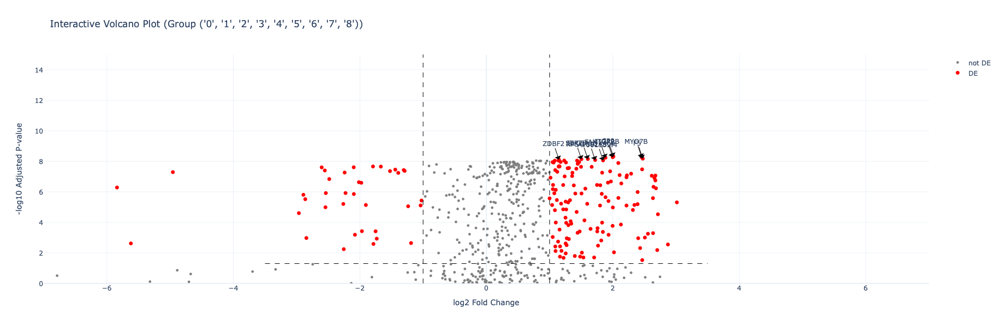

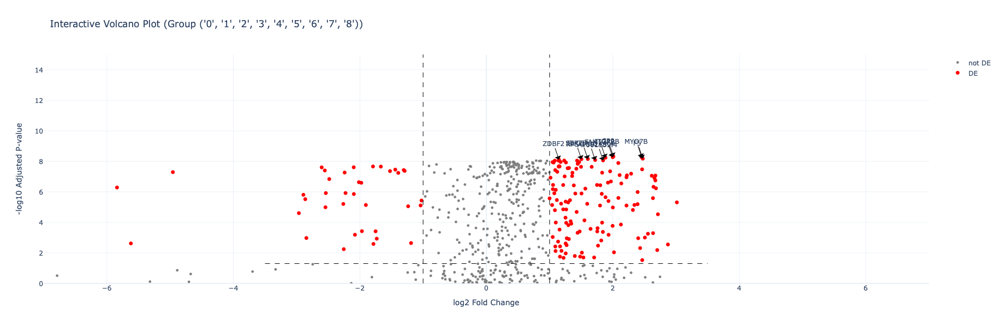

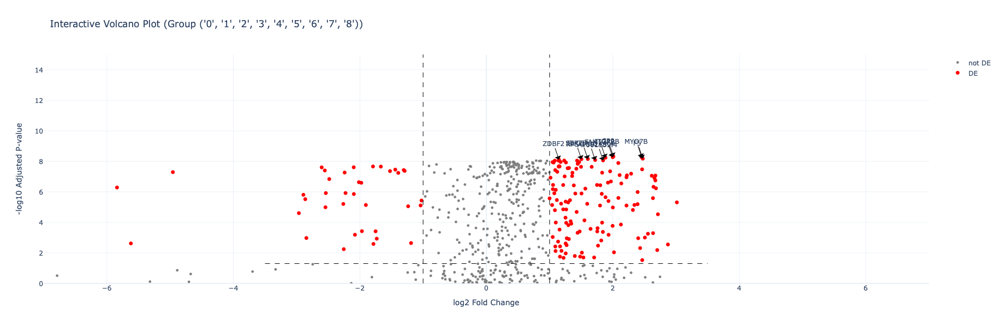

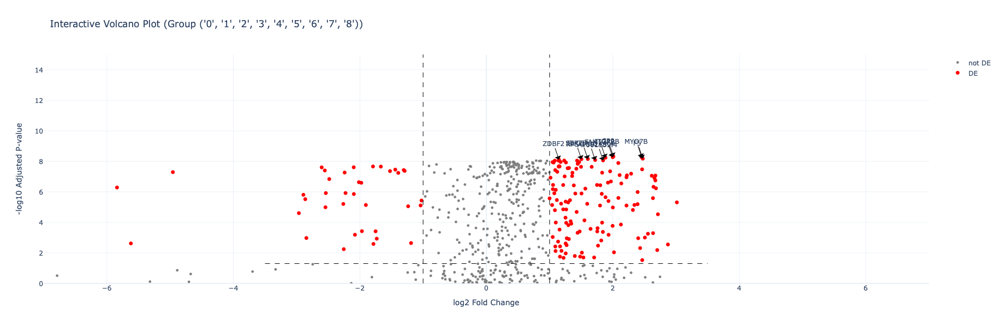

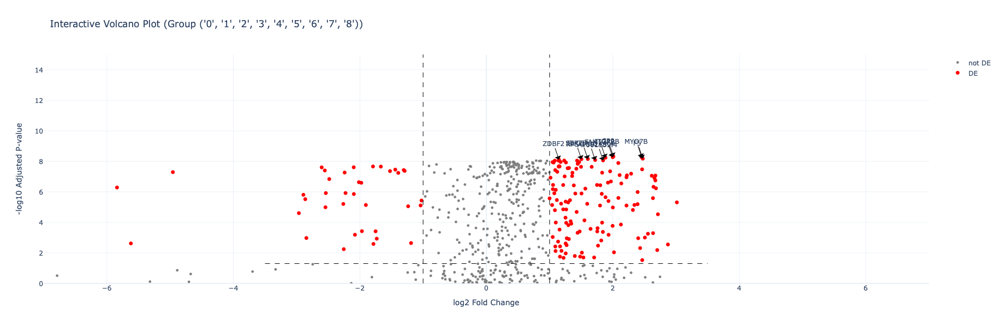

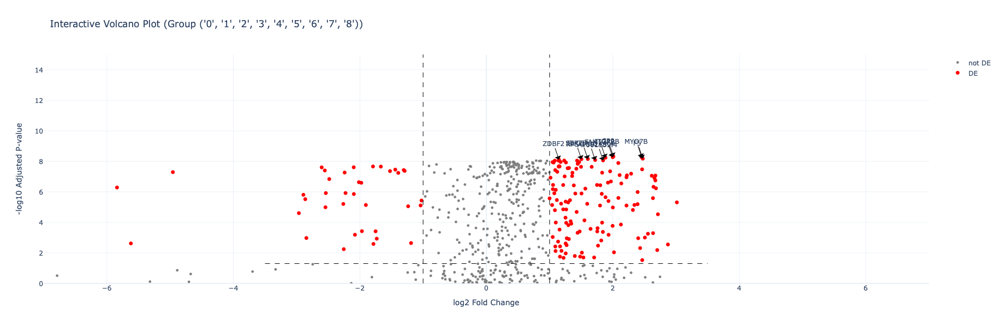

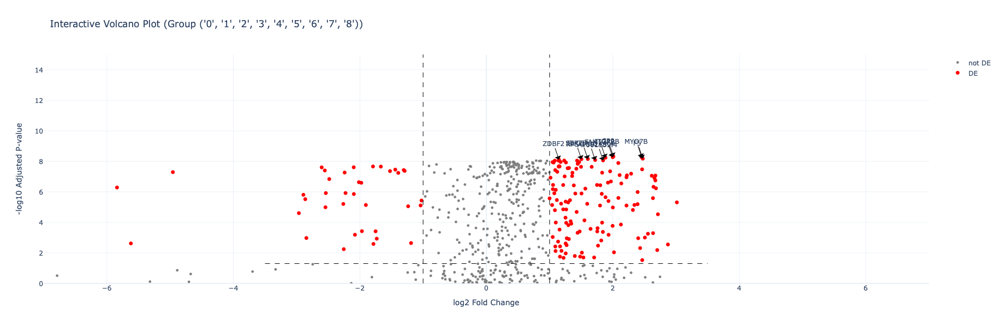

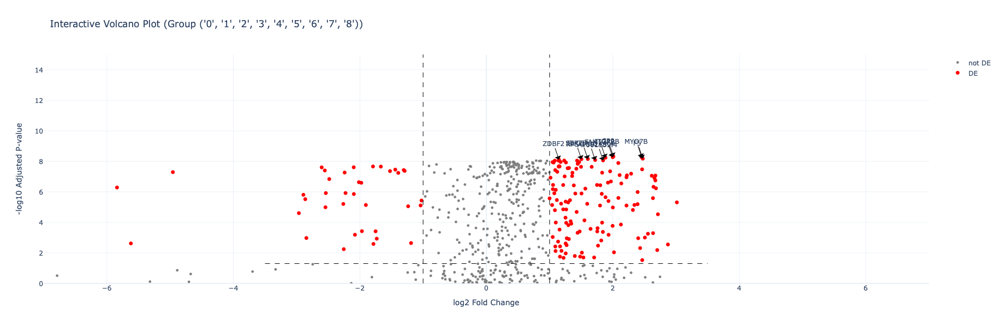

In [59]:
import plotly.express as px
import plotly.graph_objs as go

def create_interactive_volcano_plot(adata, group, pval_cutoff=0.05, log2fc_cutoff=1, top_n=10):
    
    # Get top significant genes
    
    sig_genes = de_results[(de_results['pvals_adj'] < pval_cutoff) & (de_results['log2foldchanges'].abs() >= log2fc_cutoff)]
    top_genes = sig_genes.nlargest(top_n, '-log10pvals_adj')

    # Create figure with secondary x-axis for gene labels
    fig = go.Figure()

    # Add scatter plot of non-significant genes
    fig.add_trace(go.Scatter(
        x=de_results['log2foldchanges'],
        y=de_results['-log10pvals_adj'],
        mode='markers',
        name='not DE',
        marker=dict(color='grey', size=5),
        text=de_results['gene_names'],
        hoverinfo='text'
    ))

    # Add scatter plot of significant genes
    fig.add_trace(go.Scatter(
        x=sig_genes['log2foldchanges'],
        y=sig_genes['-log10pvals_adj'],
        mode='markers',
        name='DE',
        marker=dict(color='red', size=7),
        text=sig_genes['gene_names'],
        hoverinfo='text'
    ))

    # Add labels for the top N significant genes
    for i, row in top_genes.iterrows():
        fig.add_annotation(
            x=row['log2foldchanges'],
            y=row['-log10pvals_adj'],
            text=row['gene_names'],
            showarrow=True,
            arrowhead=1,
            arrowsize=2,
            arrowwidth=1,
            arrowcolor='black'
        )

    # Set layout properties
    fig.update_layout(
        title=f'Interactive Volcano Plot (Group {group})',
        xaxis_title='log2 Fold Change',
        yaxis_title='-log10 Adjusted P-value',
        template='plotly_white', width=1000,  # Set the width of the plot
    height=600,  # Set the height of the plot
    xaxis=dict(range=[-7, 7]),
    yaxis=dict(range=[0, 15])
    )

    # Add horizontal line for p-value cutoff
    fig.add_shape(
        type='line',
        line=dict(dash='dash', color='black', width=1),
        x0=-max(de_results['log2foldchanges']), x1=max(de_results['log2foldchanges']),
        y0=-np.log10(pval_cutoff), y1=-np.log10(pval_cutoff)
    )

    # Add vertical lines for log2fc cutoffs
    fig.add_shape(
        type='line',
        line=dict(dash='dash', color='black', width=1),
        x0=-log2fc_cutoff, x1=-log2fc_cutoff,
        y0=0, y1=max(de_results['-log10pvals_adj'])
    )
    fig.add_shape(
        type='line',
        line=dict(dash='dash', color='black', width=1),
        x0=log2fc_cutoff, x1=log2fc_cutoff,
        y0=0, y1=max(de_results['-log10pvals_adj'])
    )

    # Show figure
    fig.show()

# Example usage:
for i in range(len(groups)):
    create_interactive_volcano_plot(adata, str(groups))

In [60]:
de_results['logfoldchanges'].abs()
non_null_values = de_results['log2foldchanges'][de_results['log2foldchanges'].notnull()]

# Print non-null values
print(non_null_values)

98     -0.260234
102    -1.792421
104    -1.668638
110     0.395835
111    -2.097099
          ...   
2308    2.473369
2310    1.883804
2311    2.457744
2312    1.997909
2315    2.008889
Name: log2foldchanges, Length: 601, dtype: float32


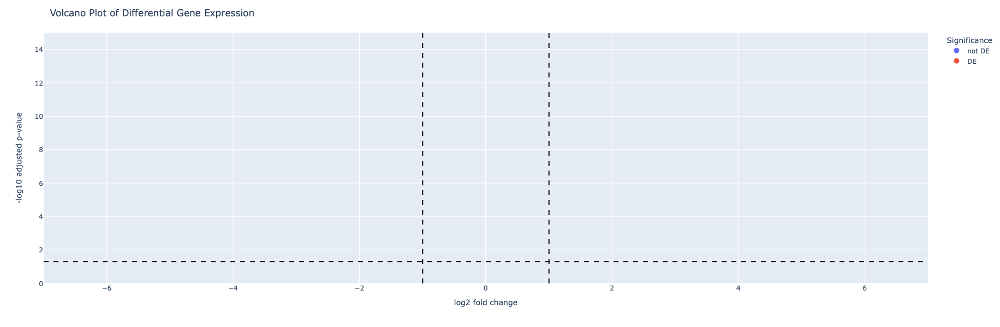

In [61]:
import plotly.express as px
import pandas as pd
import numpy as np

# Assuming de_results is prepared and contains 'gene_names', 'logfoldchanges', 'pvals_adj'

# Replace zeros and negative values in 'logfoldchanges' to avoid log2 of non-positive numbers
de_results['logfoldchanges'] = de_results['logfoldchanges'].replace(0, np.nextafter(0, 1))
de_results['log2foldchanges'] = np.sign(de_results['logfoldchanges']) * np.log2(np.abs(de_results['logfoldchanges']))

# Calculate the -log10 of adjusted p-values
de_results['-log10pvals_adj'] = -np.log10(de_results['pvals_adj'].replace(0, np.nextafter(0, 1)))

# Define your threshold for significance here
pval_cutoff = 0.05
log2fc_cutoff = 1

# Plotting with Plotly
fig = px.scatter(
    de_results, 
    x='log2foldchanges', 
    y='-log10pvals_adj',
    color=np.where((de_results['pvals_adj'] < pval_cutoff) & (np.abs(de_results['log2foldchanges']) > log2fc_cutoff), 'DE', 'not DE'),
    hover_data=['gene_names']
)

# Update traces to customize marker size
fig.update_traces(marker=dict(size=10))

# Add horizontal line for significance threshold
fig.add_hline(y=-np.log10(pval_cutoff), line_dash="dash", line_color="black")

# Add vertical lines for log2 fold change threshold
fig.add_vline(x=log2fc_cutoff, line_dash="dash", line_color="black")
fig.add_vline(x=-log2fc_cutoff, line_dash="dash", line_color="black")

# Update layout with titles and legend
fig.update_layout(
    title='Volcano Plot of Differential Gene Expression',
    xaxis_title='log2 fold change',
    yaxis_title='-log10 adjusted p-value',
    legend_title='Significance',
    showlegend=True,     
    width=800,  # Set the width of the plot
    height=600,  # Set the height of the plot
    xaxis=dict(range=[-7, 7]),
    yaxis=dict(range=[0, 15])
)

# Show plot
fig.show()

In [62]:
import pandas as pd

In [63]:
pd.DataFrame(adata.uns["rank_genes_groups"]["names"]).head(5)

,0,1,2,3,4,5,6,7,8
0,CCL5,CD74,LDHB,CD8B,S100A9,NKG7,FCGR3A,ZNF574,PPBP
1,NKG7,HLA-DRA,LTB,CD3D,LYZ,GNLY,RP11-159H10.3,RP11-420A6.2,ILK
2,CST7,HLA-DQA1,CD3D,LDHB,S100A8,GZMB,RP11-643M14.1,SLC14A2,ABCC3
3,GZMA,HLA-DPB1,IL7R,CCR7,FCN1,PRF1,CCDC163P,NEDD4,GPX1
4,CTSW,HLA-DRB1,IL32,CD7,CST3,CTSW,AK4,RP11-336K24.12,RGS18


In [64]:
result = adata.uns["rank_genes_groups"]
groups = result["names"].dtype.names
print(groups)
print(result)


('0', '1', '2', '3', '4', '5', '6', '7', '8')
{'params': {'groupby': 'leiden', 'reference': 'rest', 'method': 'wilcoxon', 'use_raw': False, 'layer': None, 'corr_method': 'benjamini-hochberg'}, 'names': rec.array([('CCL5', 'CD74', 'LDHB', 'CD8B', 'S100A9', 'NKG7', 'FCGR3A', 'ZNF574', 'PPBP'),
           ('NKG7', 'HLA-DRA', 'LTB', 'CD3D', 'LYZ', 'GNLY', 'RP11-159H10.3', 'RP11-420A6.2', 'ILK'),
           ('CST7', 'HLA-DQA1', 'CD3D', 'LDHB', 'S100A8', 'GZMB', 'RP11-643M14.1', 'SLC14A2', 'ABCC3'),
           ...,
           ('AIF1', 'IL32', 'HLA-DRA', 'CYBA', 'CD3D', 'CD3D', 'AC113189.5', 'GOSR2', 'CD3D'),
           ('HLA-DRA', 'S100A4', 'CD74', 'S100A11', 'IL32', 'COTL1', 'CLEC4E', 'VSTM1', 'LTB'),
           ('CD79A', 'CD3D', 'HLA-DRB1', 'HLA-DRB1', 'LTB', 'LTB', 'FCER1A', 'CDA', 'BTG1')],
          dtype=[('0', 'O'), ('1', 'O'), ('2', 'O'), ('3', 'O'), ('4', 'O'), ('5', 'O'), ('6', 'O'), ('7', 'O'), ('8', 'O')]), 'scores': rec.array([( 25.543476,  28.693123,  28.321285,  13.479356,  33

In [65]:
!pip install celltypist
!pip install decoupler

  Using cached celltypist-1.6.2-py3-none-any.whl (7.3 MB)
  Using cached openpyxl-3.1.2-py2.py3-none-any.whl (249 kB)
  Using cached et_xmlfile-1.1.0-py3-none-any.whl (4.7 kB)
  Using cached decoupler-1.6.0-py3-none-any.whl (95 kB)


In [66]:
import celltypist as ct
import decoupler as dc


In [67]:
sc.tl.leiden(adata, key_added="leiden_res0_02", resolution=0.02)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res2", resolution=2)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden_res0_02', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 6 clusters and added
    'leiden_res0_5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 20 clusters and added
    'leiden_res2', the cluster labels (adata.obs, categorical) (0:00:00)


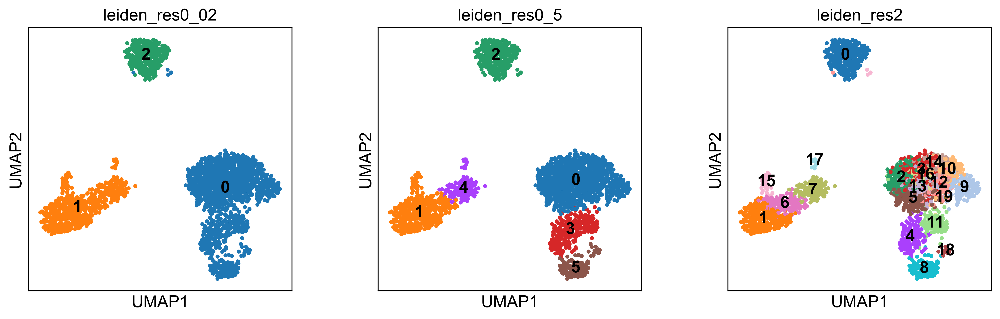

In [68]:
sc.pl.umap(
    adata,
    color=["leiden_res0_02", "leiden_res0_5", "leiden_res2"],
    legend_loc="on data",
)

In [69]:
sc.settings.verbosity = 2 

In [70]:
sc.settings.verbosity = 2 

In [71]:
marker_genes = {
    "CD14+ Mono": ["FCN1", "CD14"],
    "CD16+ Mono": ["TCF7L2", "FCGR3A", "LYN"],
    "cDC2": [
        "CST3",
        "COTL1",
        "LYZ",
        "DMXL2",
        "CLEC10A",
        "FCER1A",
    ],  # Note: DMXL2 should be negative
    "Erythroblast": ["MKI67", "HBA1", "HBB"],
    "Proerythroblast": [
        "CDK6",
        "SYNGR1",
        "HBM",
        "GYPA",
    ],  # Note HBM and GYPA are negative markers
    "NK": ["GNLY", "NKG7", "CD247", "FCER1G", "TYROBP", "KLRG1", "FCGR3A"],
    "ILC": ["ID2", "PLCG2", "GNLY", "SYNE1"],
    "Naive CD20+ B": ["MS4A1", "IL4R", "IGHD", "FCRL1", "IGHM"],
    "B cells": [
        "MS4A1",
        "ITGB1",
        "COL4A4",
        "PRDM1",
        "IRF4",
        "PAX5",
        "BCL11A",
        "BLK",
        "IGHD",
        "IGHM",
    ],  # Note IGHD and IGHM are negative markers
    "Plasma cells": ["MZB1", "HSP90B1", "FNDC3B", "PRDM1", "IGKC", "JCHAIN"],
    "Plasmablast": ["XBP1", "PRDM1", "PAX5"],  # Note PAX5 is a negative marker
    "CD4+ T": ["CD4", "IL7R", "TRBC2"],
    "CD8+ T": ["CD8A", "CD8B", "GZMK", "GZMA", "CCL5", "GZMB", "GZMH", "GZMA"],
    "T naive": ["LEF1", "CCR7", "TCF7"],
    "pDC": ["GZMB", "IL3RA", "COBLL1", "TCF4"],
}

In [72]:
marker_genes_dict = {
    "B-cell": ["CD79A", "MS4A1"],
    "Dendritic": ["FCER1A", "CST3"],
    "Monocytes": ["FCGR3A"],
    "NK": ["GNLY", "NKG7"],
    "Plasma": ["MZB1"],
    "B cells": ['BRWD1', 'BACE2']
}

In [73]:
sc.settings.verbosity = 2 

ranking genes
    finished (0:00:01)


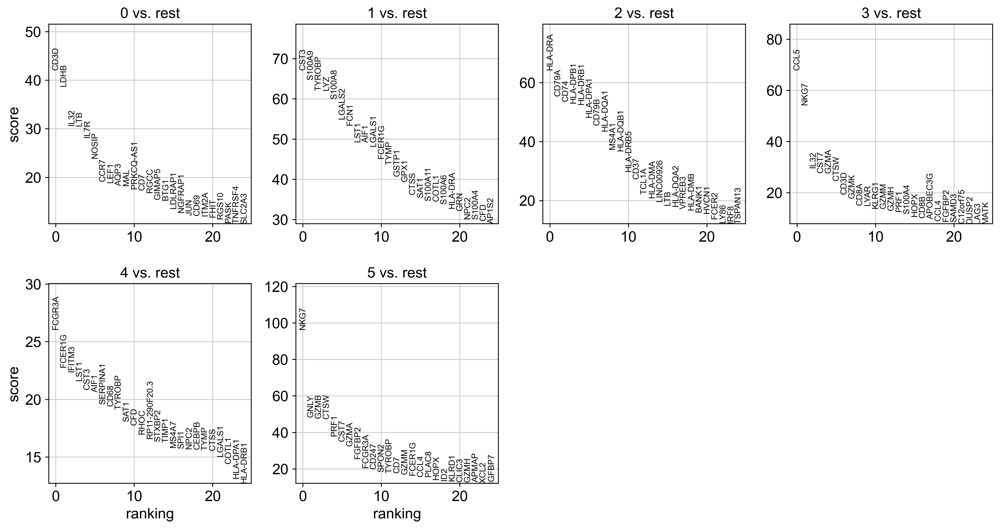

In [74]:
sc.tl.rank_genes_groups(adata, 'leiden_res0_5', method='t-test', key_added = "t-test")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "t-test")

ranking genes
    finished (0:00:01)


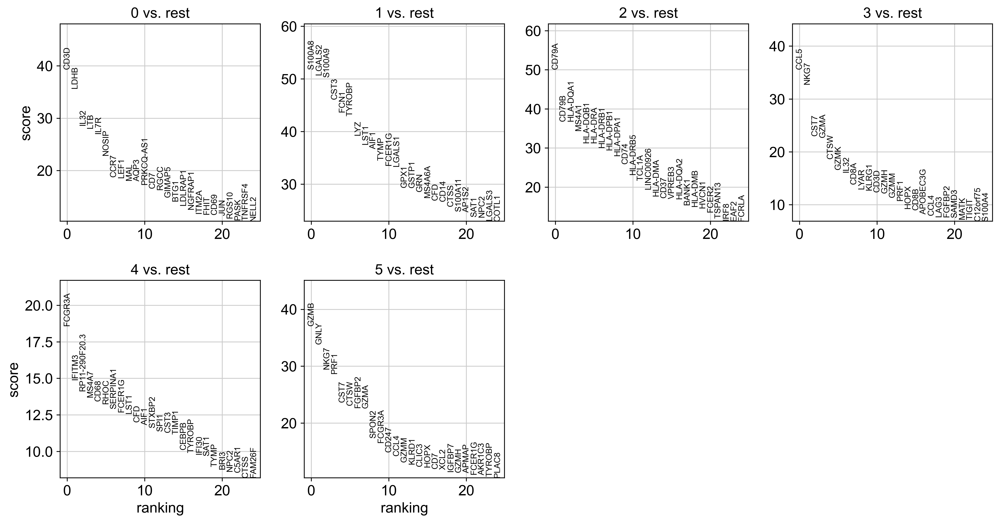

In [75]:

sc.tl.rank_genes_groups(adata, 'leiden_res0_5', method='t-test_overestim_var', key_added = "t-test_ov")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "t-test_ov")

ranking genes
    finished (0:00:02)


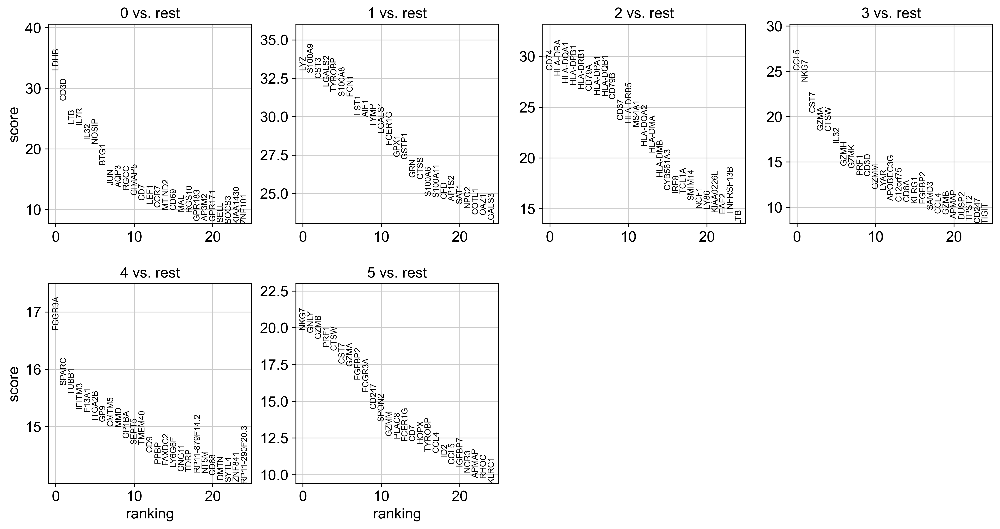

In [76]:

sc.tl.rank_genes_groups(adata, 'leiden_res0_5', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "wilcoxon")

ranking genes
    finished (0:00:00)


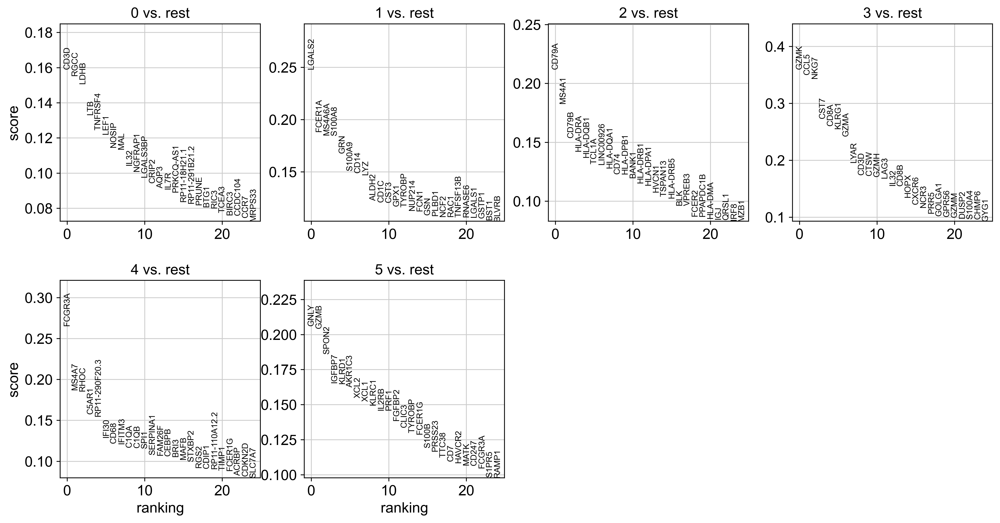

In [77]:







sc.tl.rank_genes_groups(adata, 'leiden_res0_5', method='logreg',key_added = "logreg")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "logreg")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


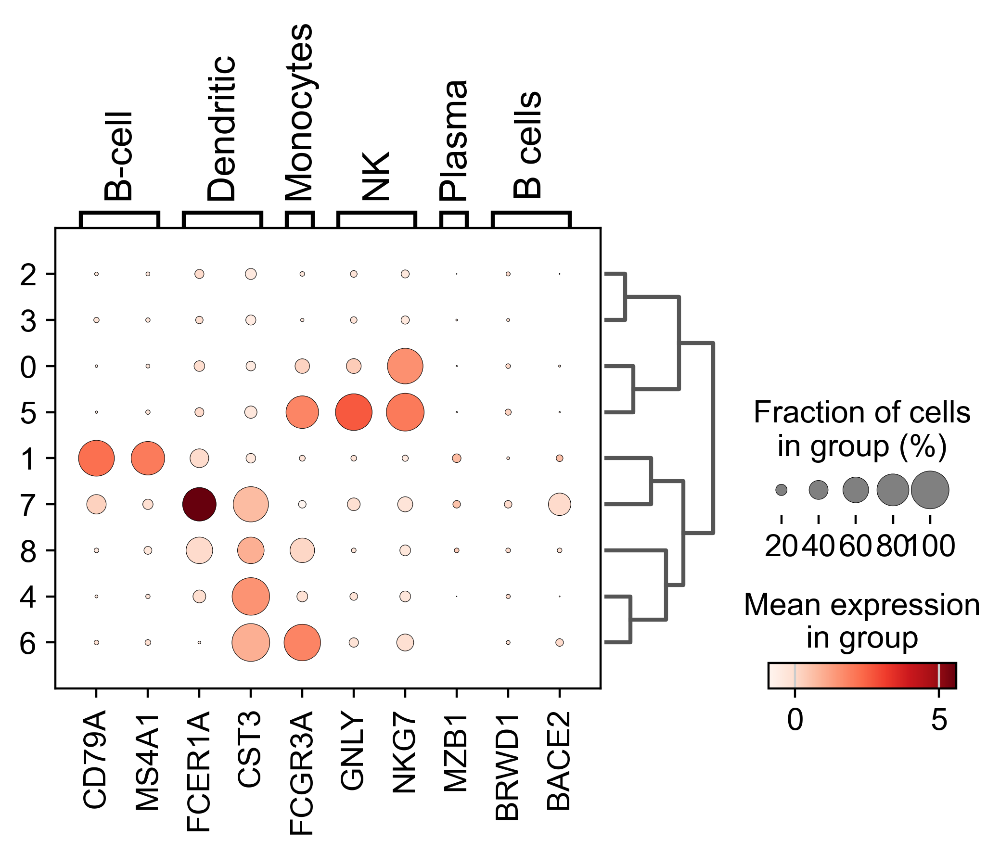

In [78]:
sc.pl.dotplot(adata, marker_genes_dict, groupby="leiden", dendrogram=True)

In [79]:
adata.var_names

Index(['ISG15', 'AGRN', 'TNFRSF4', 'CPSF3L', 'ATAD3C', 'CDK11B', 'RP5-892K4.1',
       'PLEKHG5', 'NOL9', 'CAMTA1',
       ...
       'AIRE', 'AP001062.7', 'PCBP3', 'S100B', 'PRMT2', 'MT-ND2', 'MT-ATP8',
       'MT-ATP6', 'AC145212.1', 'AL592183.1'],
      dtype='object', name='index', length=2365)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res0_5']`
categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


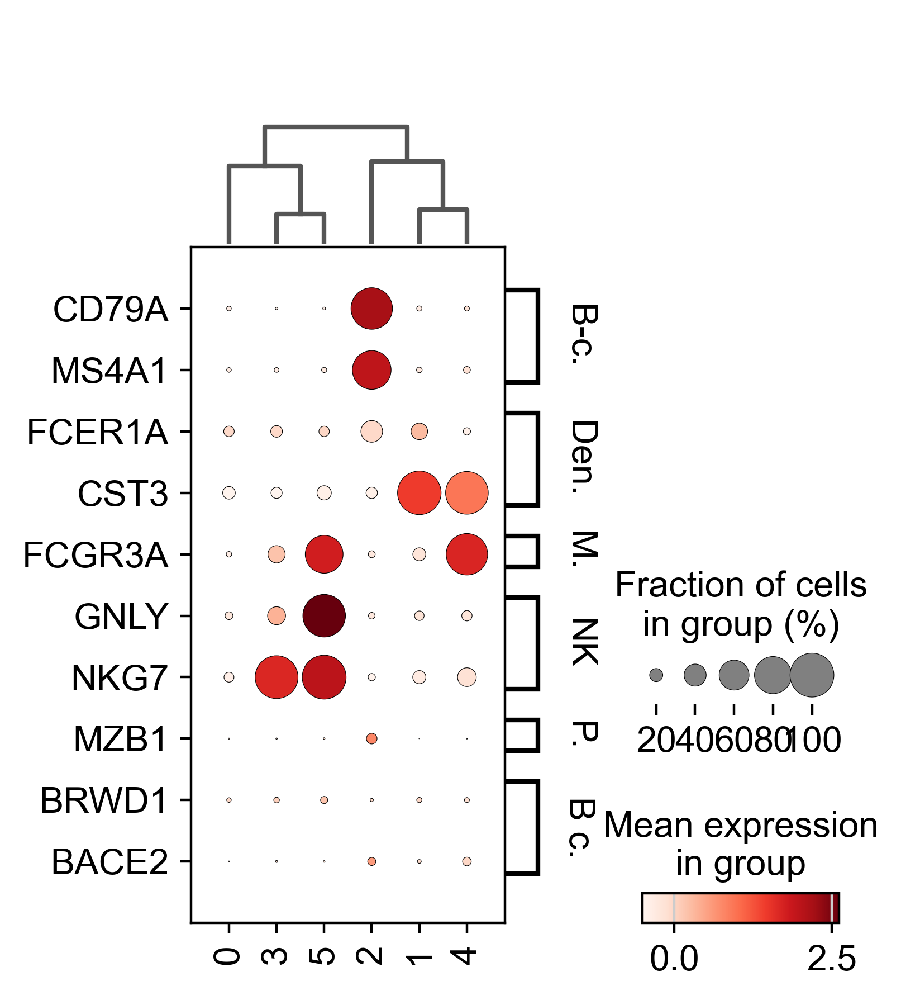

In [80]:
sc.pl.dotplot(adata, marker_genes_dict,swap_axes=True, groupby="leiden_res0_5", dendrogram =True)

In [81]:
new_cluster_names = {
    "0": "CD4+ T cells",
    "1": "CD4+ T cells",
    "2": "Erythroblast",
    "3": "CD14+ Mono",
    "4": "CD8+ T cells",
    "5": "Naive CD20+ B Cells",
    "6": "Proerythroblast",
    "7": "CD4+ T cells",  # though questinable
    "8": "Naive CD20+ B Cells",
    "9": "Erythroblast",
    "10": "NK",
    "11": "Unknown",
    "12": "B cells",
    "13": "Plasma Cells",
    "14": "cDC2",
    "15": "CD14+ Mono",
    "16": "Proerythroblast",
    "17": "Proerythroblast",
}

In [82]:
adata.obs["manual_anno"] = adata.obs["leiden_res0_5"].map(new_cluster_names)

... storing 'manual_anno' as categorical


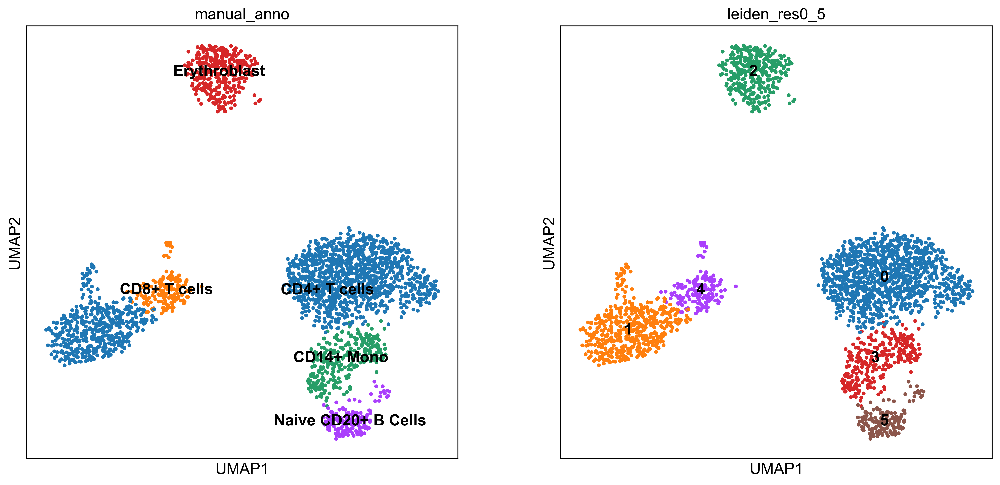

In [83]:
with plt.rc_context({"figure.figsize": (7, 7)}):
    sc.pl.umap(
        adata,
        color=["manual_anno", "leiden_res0_5"],
        legend_loc="on data",
    )

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_manual_anno']`


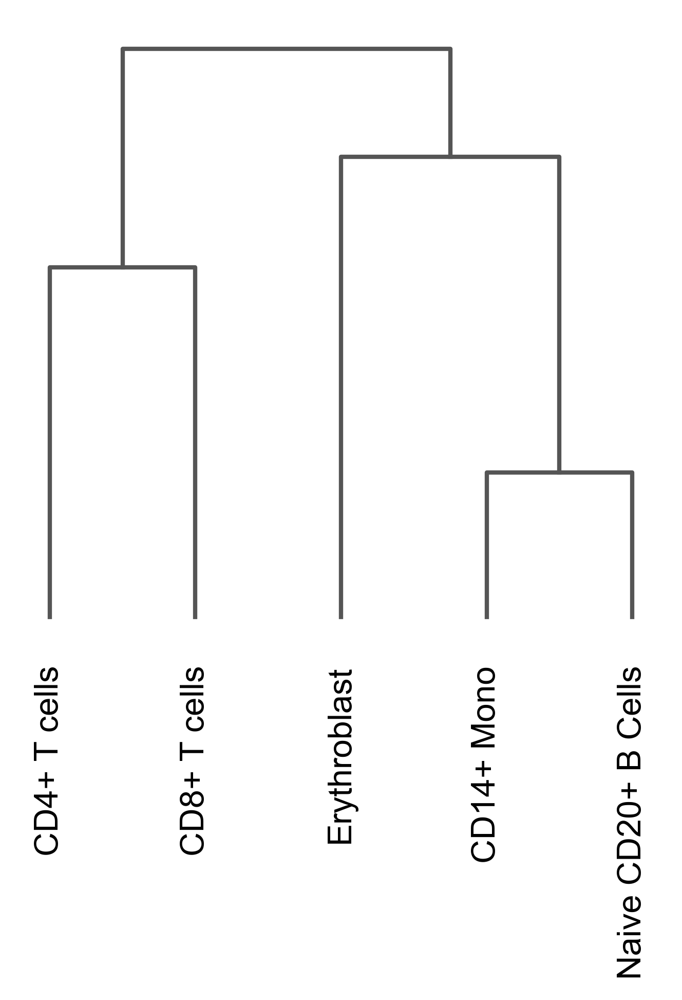

<Axes: >

In [84]:
sc.pl.dendrogram(adata, groupby="manual_anno")

In [85]:
adata.obs["manual_anno"] = adata.obs["manual_anno"].replace("Unknown", "B-cell lineage")

In [86]:
ct.models.download_models(model=["Immune_All_Low.pkl"], force_update=True)

📜 Retrieving model list from server https://celltypist.cog.sanger.ac.uk/models/models.json
📚 Total models in list: 44
📂 Storing models in /home/jovyan/.celltypist/data/models
💾 Total models to download: 1
💾 Downloading model [1/1]: Immune_All_Low.pkl


In [87]:
!pip install omnipath


  Using cached omnipath-1.0.8-py3-none-any.whl (68 kB)
  Using cached docrep-0.3.2-py3-none-any.whl
  Using cached inflect-7.2.0-py3-none-any.whl (34 kB)
  Using cached more_itertools-10.2.0-py3-none-any.whl (57 kB)


In [88]:
!pip install pypath


  Using cached pypath-0.1-py3-none-any.whl


In [89]:
!pip install git+https://github.com/saezlab/pypath.git


  Cloning https://github.com/saezlab/pypath.git to /tmp/pip-req-build-rsxxzugw
  Running command git clone --filter=blob:none --quiet https://github.com/saezlab/pypath.git /tmp/pip-req-build-rsxxzugw
  Resolved https://github.com/saezlab/pypath.git to commit 7f2c52016b6ecdd7dbac35861583a5ce852ead57
  Running command git submodule update --init --recursive -q
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached cryptography-42.0.5-cp39-abi3-manylinux_2_28_x86_64.whl (4.6 MB)
  Using cached dill-0.3.8-py3-none-any.whl (116 kB)
  Using cached glom-23.5.0-py3-none-any.whl (102 kB)
  Using cached pypath_common-0.2.0-py3-none-any.whl
  Using cached pyreadr-0.5.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (440 kB)
  Using cached pysftp-0.2.9-py3-none-any.whl
  Using cached rdata-0.11.2-py3-none-any.whl (46 kB)
  Using cached sqlparse-0.4.4-py3-none-any.whl (41 kB)
  Using cached ti

In [90]:
# Query Omnipath and get PanglaoDB
markers = dc.get_resource(name="PanglaoDB", organism="human")

markers.head()



,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
0,CTRB1,False,Enterocytes,Endoderm,True,0.000000,0.004394,True,0.003311,0.020480,9606,GI tract,0.017
1,CTRB1,True,Acinar cells,Endoderm,True,1.000000,0.000629,True,0.957143,0.015920,9606,Pancreas,0.017
2,KLK1,True,Endothelial cells,Mesoderm,True,0.000000,0.008420,True,0.000000,0.014915,9606,Vasculature,0.013
3,KLK1,False,Goblet cells,Endoderm,True,0.588235,0.005039,True,0.903226,0.012408,9606,GI tract,0.013
4,KLK1,False,Epithelial cells,Mesoderm,True,0.000000,0.008233,True,0.225806,0.013758,9606,Epithelium,0.013


In [91]:
markers = markers[~markers.duplicated(["cell_type", "genesymbol"])]
markers.tail()

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
8456,SLC14A1,True,Urothelial cells,Mesoderm,True,0.0,0.01817,True,0.0,0.0,9606,Urinary bladder,0.008
8457,UPK3A,True,Urothelial cells,Mesoderm,True,0.0,0.00000,True,0.0,0.0,9606,Urinary bladder,0.000
8458,UPK1A,True,Urothelial cells,Mesoderm,True,0.0,0.00000,True,0.0,0.0,9606,Urinary bladder,0.000
8459,UPK2,True,Urothelial cells,Mesoderm,True,0.0,0.00000,True,0.0,0.0,9606,Urinary bladder,0.000
8460,UPK3B,True,Urothelial cells,Mesoderm,True,0.0,0.00000,True,0.0,0.0,9606,Urinary bladder,0.000


In [92]:
# Assuming 'markers' is your DataFrame
markers = markers[markers["canonical_marker"] == True]  # Filtering rows where 'canonical_marker' is True

markers.head()

,genesymbol,canonical_marker,cell_type,germ_layer,human,human_sensitivity,human_specificity,mouse,mouse_sensitivity,mouse_specificity,ncbi_tax_id,organ,ubiquitiousness
1,CTRB1,True,Acinar cells,Endoderm,True,1.000000,0.000629,True,0.957143,0.015920,9606,Pancreas,0.017
2,KLK1,True,Endothelial cells,Mesoderm,True,0.000000,0.008420,True,0.000000,0.014915,9606,Vasculature,0.013
5,KLK1,True,Principal cells,Mesoderm,True,0.000000,0.008145,True,0.285714,0.014058,9606,Kidney,0.013
6,KLK1,True,Acinar cells,Endoderm,True,0.833333,0.005031,True,0.314286,0.012826,9606,Pancreas,0.013
7,KLK1,True,Plasmacytoid dendritic cells,Mesoderm,True,0.000000,0.008202,True,1.000000,0.012914,9606,Immune system,0.013


In [93]:
dc.run_mlm(mat=adata, net=markers, weight=None, source="cell_type", target="genesymbol", verbose=True, use_raw=False)

Running mlm on mat with 2638 samples and 2365 targets for 56 sources.


In [94]:
adata.obsm["mlm_estimate"].head()

,Ductal cells,Cholangiocytes,Enterocytes,Platelets,Neutrophils,Kupffer cells,Dendritic cells,Paneth cells,Natural killer T cells,T helper cells,...,Neurons,Interneurons,Tuft cells,Cardiomyocytes,Hepatic stellate cells,Gamma (PP) cells,Oligodendrocytes,Proximal tubule cells,Smooth muscle cells,Epsilon cells
AAACATACAACCAC-1,-0.163891,-0.568824,-0.260467,-1.166276,-0.345844,0.320547,-1.169296,0.021598,-0.008519,1.059817,...,-0.108273,0.817675,-0.672242,-0.255450,-0.158975,-0.568459,-0.412433,-0.203951,-0.464650,-1.097439
AAACATTGAGCTAC-1,0.071432,-0.424240,-0.521481,0.065059,-1.047247,-0.234368,1.158318,1.873088,-0.234574,-0.423647,...,0.896952,0.214659,-1.271540,1.122955,-0.046904,-0.436586,-0.139839,-0.177011,-0.415040,-0.466297
AAACATTGATCAGC-1,-0.329234,-0.482854,-0.668591,0.219033,0.095669,-0.027422,-1.873305,0.831981,2.162054,0.389930,...,-0.503531,-0.535699,-1.005201,3.429083,-0.539349,0.532003,-0.123340,0.089146,0.014248,-0.236226
AAACCGTGCTTCCG-1,-0.928859,0.006989,0.594869,-0.095364,-0.466119,-1.251956,1.470618,0.992480,0.870181,-1.342021,...,-0.216356,0.479067,2.619738,-0.589874,0.337562,-0.192181,-0.359469,-0.294403,-0.175037,0.224765
AAACCGTGTATGCG-1,-0.113975,0.425096,-0.267810,-1.141505,-0.518472,0.001433,-0.293447,-0.499202,2.704958,-0.576793,...,0.201386,-0.287000,-0.114379,-0.243178,1.754764,0.365990,-0.570751,-0.008237,1.090460,-0.906998


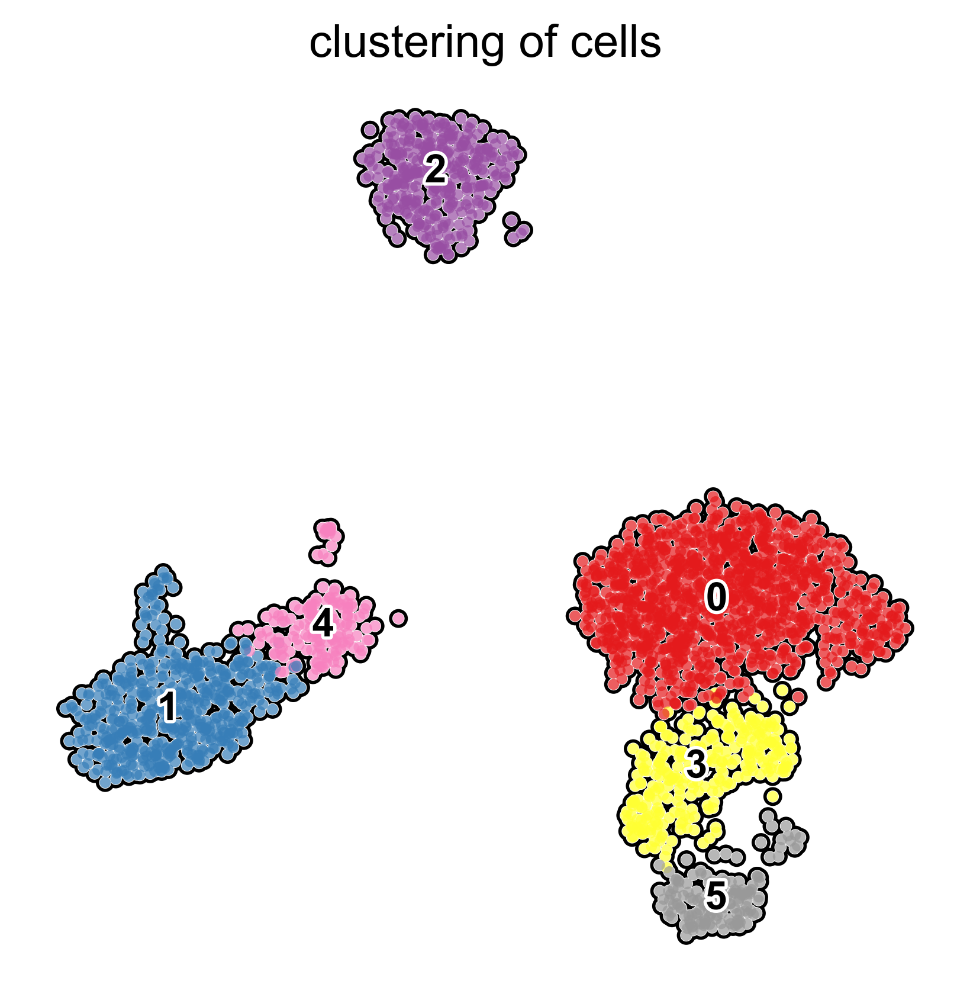

In [95]:
from matplotlib.pyplot import rc_context

with rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(
        adata,
        color="leiden_res0_5",
        add_outline=True,
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        frameon=False,
        title="clustering of cells",
        palette="Set1",
        save="cell_clustering_leiden"
    )

In [96]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="leiden")
# Filter those
sc.tl.filter_rank_genes_groups(adata, min_fold_change=1.5)

ranking genes
    finished (0:00:02)
Filtering genes using: min_in_group_fraction: 0.25 min_fold_change: 1.5, max_out_group_fraction: 0.5


categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


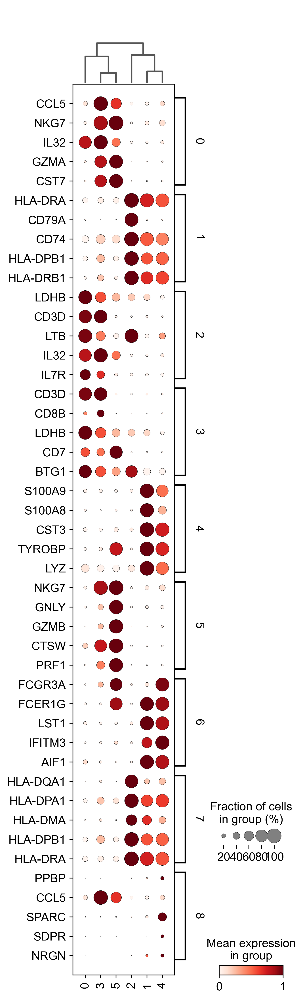

In [97]:
sc.pl.rank_genes_groups_dotplot(adata, groupby="leiden_res0_5", standard_scale="var",save= "RRG_dot_plot.pdf", swap_axes=True, n_genes=5, show =True)

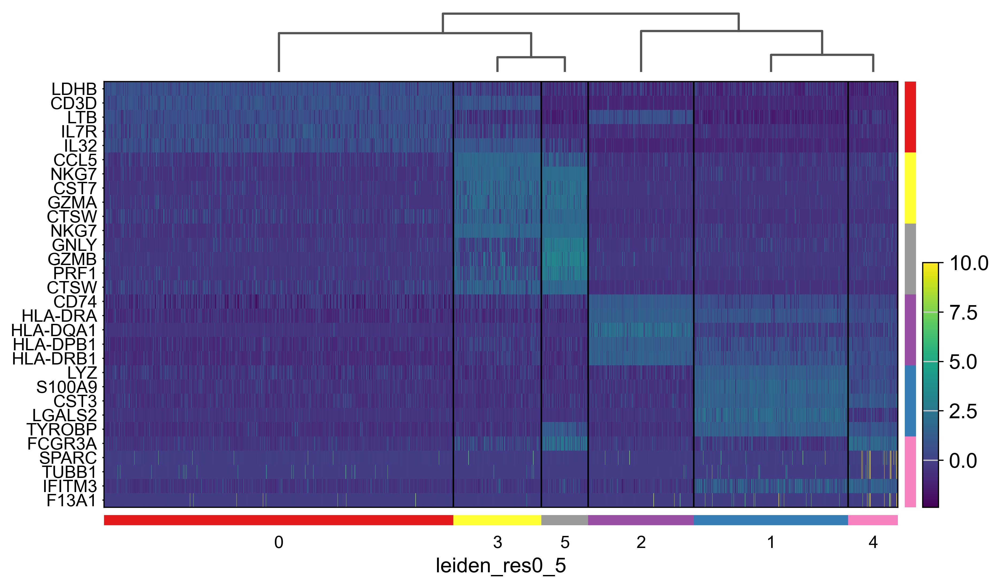

In [98]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=5,swap_axes=True, key="wilcoxon", groupby="leiden_res0_5", show_gene_labels=True, save= "RGGHeatmap.pdf", )

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

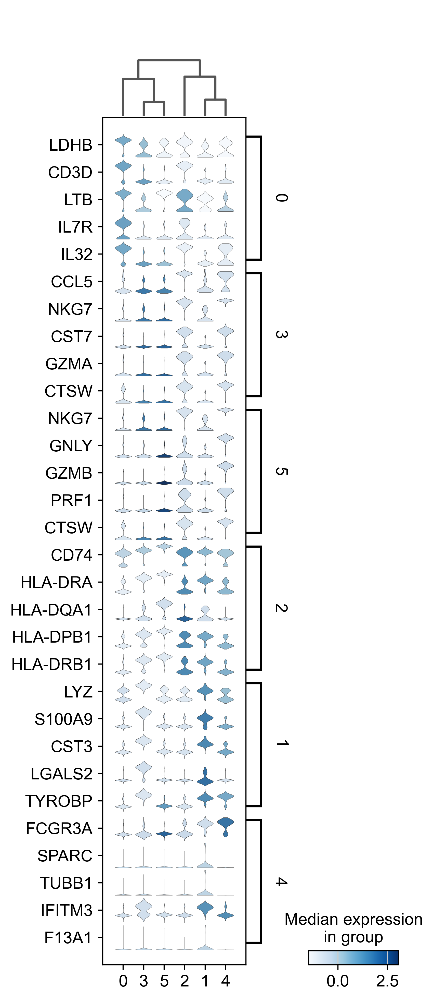

In [99]:
sc.pl.rank_genes_groups_stacked_violin(adata,swap_axes=True, n_genes=5, key="wilcoxon", groupby="leiden_res0_5")

categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


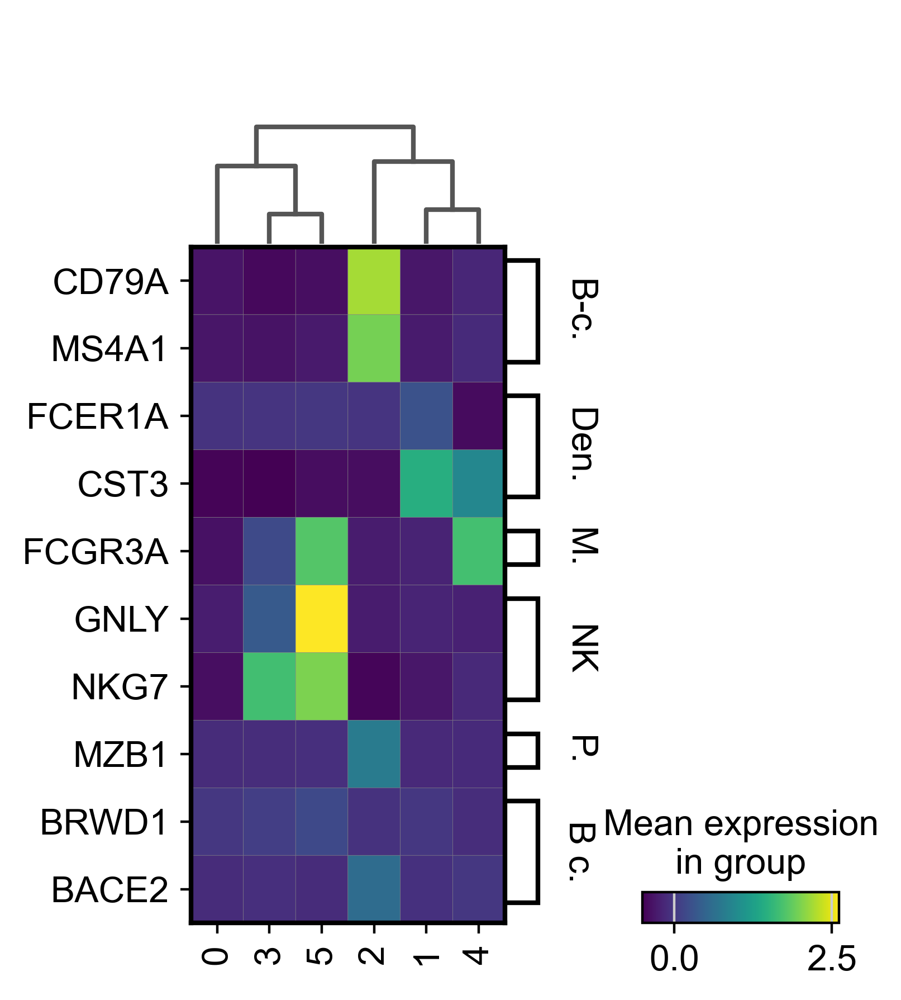

In [100]:
sc.pl.matrixplot(adata, marker_genes_dict,swap_axes=True, groupby='leiden_res0_5', dendrogram=True, use_raw=False, save="wilcoxon")

categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


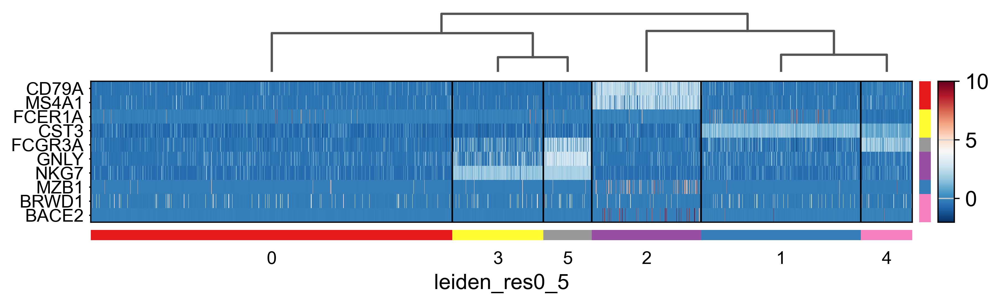

In [101]:
sc.pl.heatmap(adata, marker_genes_dict, swap_axes=True, dendrogram=True,cmap="RdBu_r", groupby="leiden_res0_5", show_gene_labels=True, save="normal_heatmap.pdf")

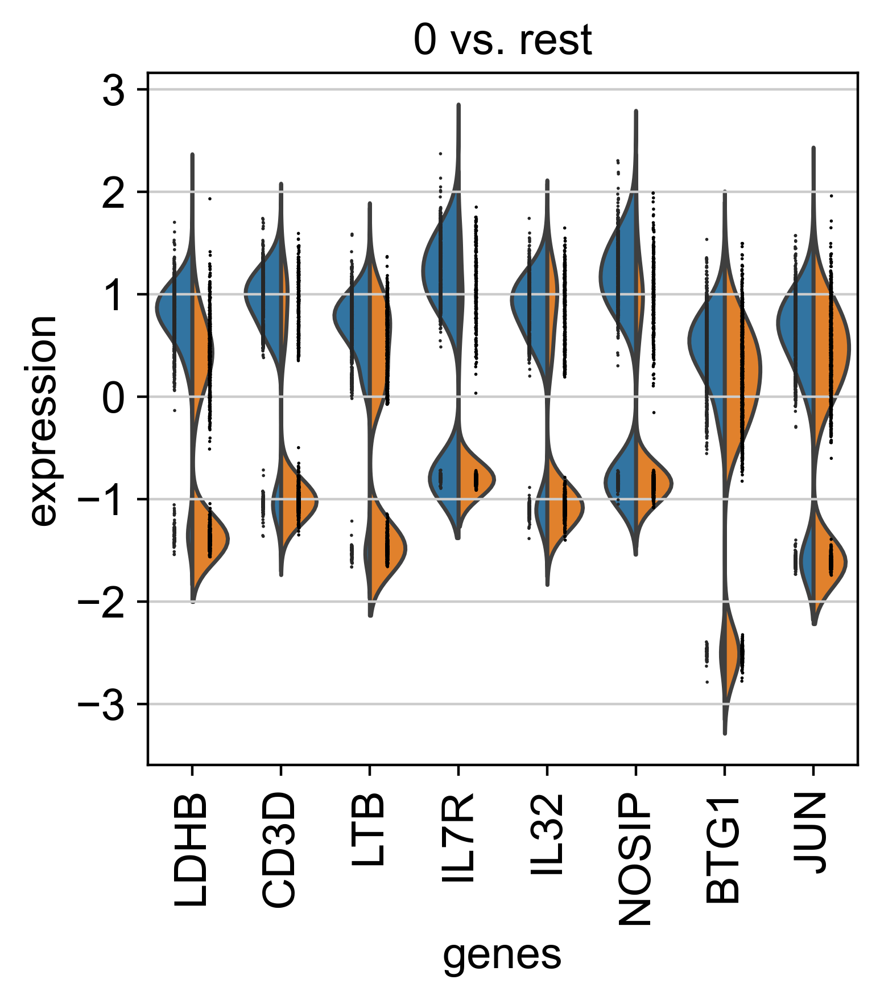

In [102]:
sc.pl.rank_genes_groups_violin(adata, groups='0', n_genes=8, jitter= 0.01, split= True, strip= True, key="wilcoxon")

In [103]:
help(sc.pl.rank_genes_groups_violin)

Help on function rank_genes_groups_violin in module scanpy.plotting._tools:

rank_genes_groups_violin(adata: 'AnnData', groups: 'Sequence[str] | None' = None, *, n_genes: 'int' = 20, gene_names: 'Iterable[str] | None' = None, gene_symbols: 'str | None' = None, use_raw: 'bool | None' = None, key: 'str | None' = None, split: 'bool' = True, density_norm: "Literal['area', 'count', 'width']" = 'width', strip: 'bool' = True, jitter: 'int | float | bool' = True, size: 'int' = 1, ax: 'Axes | None' = None, show: 'bool | None' = None, save: 'bool | None' = None, scale: "Literal['area', 'count', 'width'] | None" = None)
    Plot ranking of genes for all tested comparisons.
    
    Parameters
    ----------
    adata
        Annotated data matrix.
    groups
        List of group names.
    n_genes
        Number of genes to show. Is ignored if `gene_names` is passed.
    gene_names
        List of genes to plot. Is only useful if interested in a custom gene list,
        which is not the result 

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

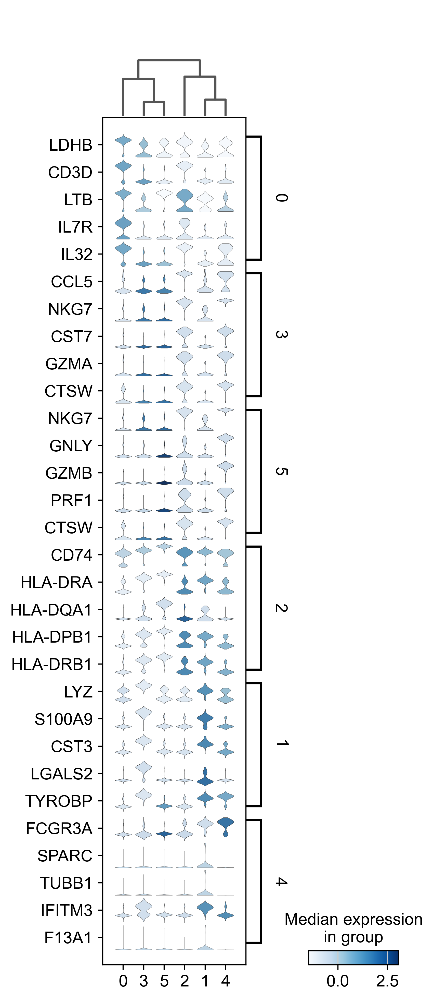

In [104]:
sc.pl.rank_genes_groups_stacked_violin(adata,swap_axes=True, n_genes=5, key="wilcoxon", groupby="leiden_res0_5", save="RGGStackedViolin£.pdf")

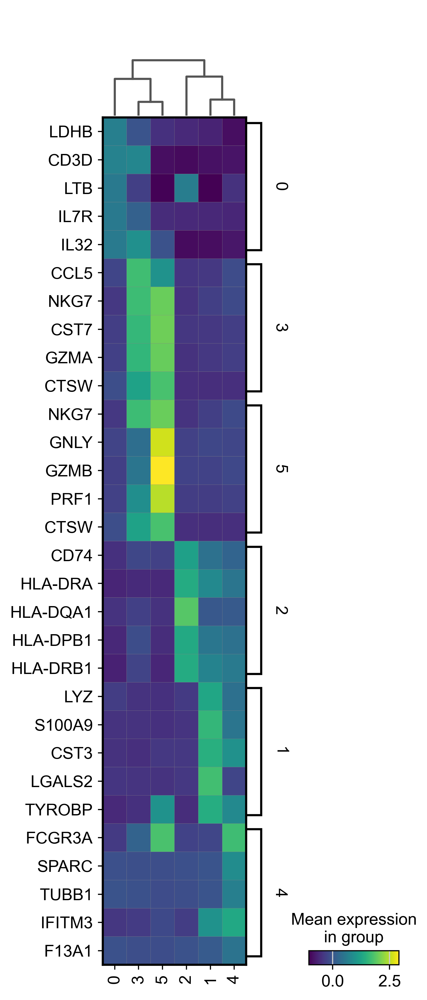

In [105]:
sc.pl.rank_genes_groups_matrixplot(adata, swap_axes= True, n_genes=5, key="wilcoxon", groupby="leiden_res0_5", save="RGGmatrix.pdf")

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

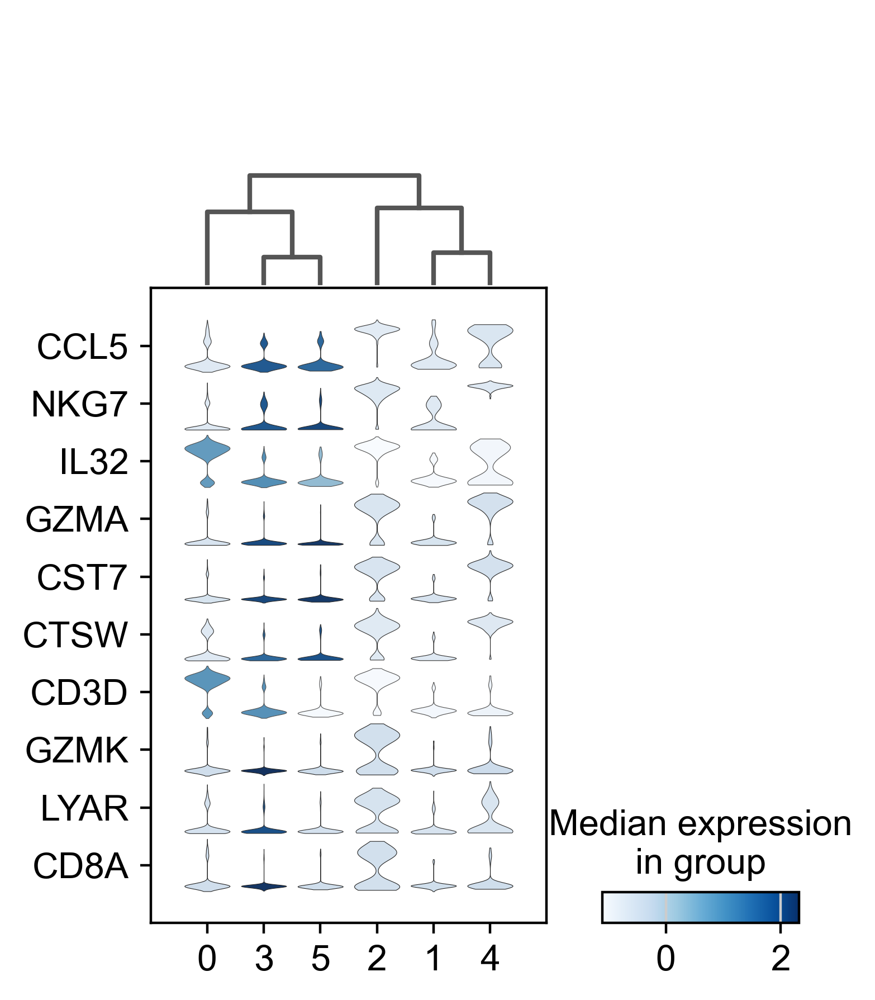

In [106]:
# plot the same genes as violins across all the datasets.

# convert numpy.recarray to list
mynames = [x[0] for x in adata.uns['rank_genes_groups']['names'][:10]]
sc.pl.stacked_violin(adata, mynames, groupby = 'leiden_res0_5',save="stackedviolin.pdf",swap_axes=True, dendrogram=True
)

categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


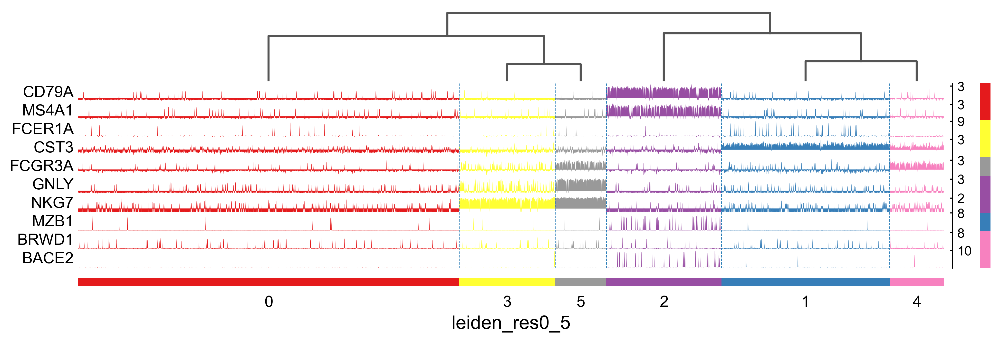

In [107]:
ax = sc.pl.tracksplot(adata, marker_genes_dict, groupby="leiden_res0_5", dendrogram=True,save="tracks_plot.pdf")



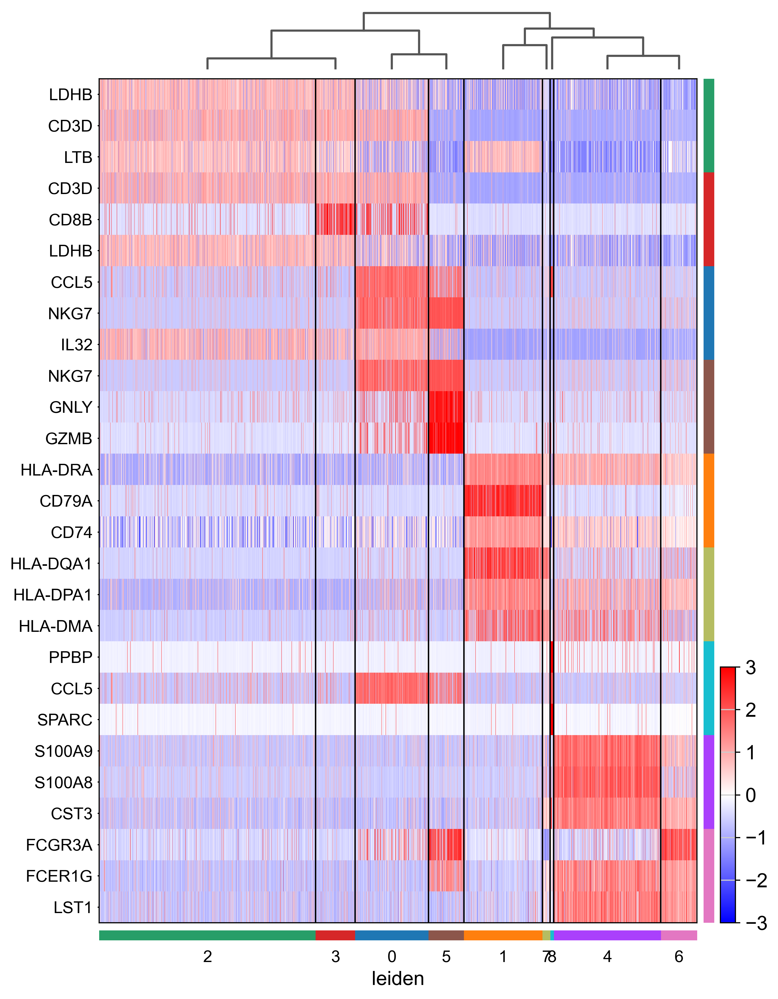

In [108]:
sc.pl.rank_genes_groups_heatmap(
    adata,
    n_genes=3,
    use_raw=False,
    swap_axes=True,
    vmin=-3,
    vmax=3,
    cmap="bwr",
    figsize=(8, 12),
    show=True,
    show_gene_labels=True,save="heat_map_rgg.pdf"
);

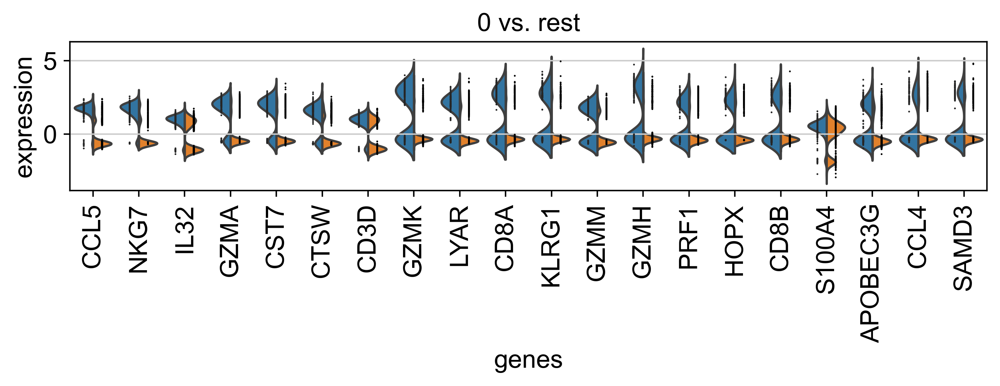

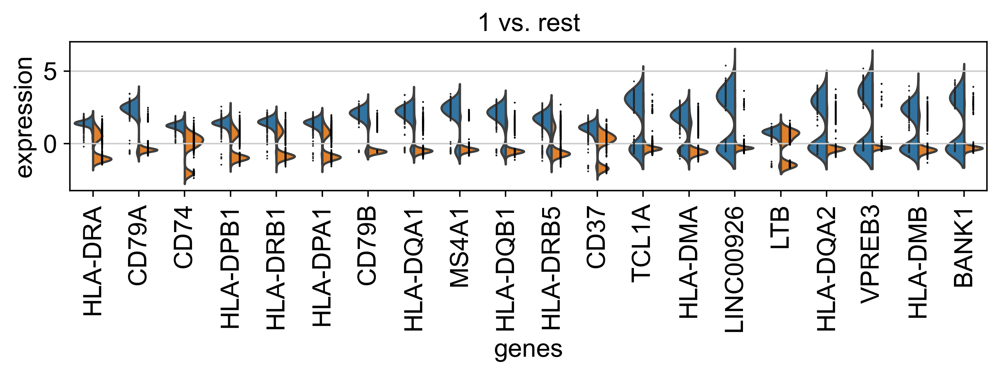

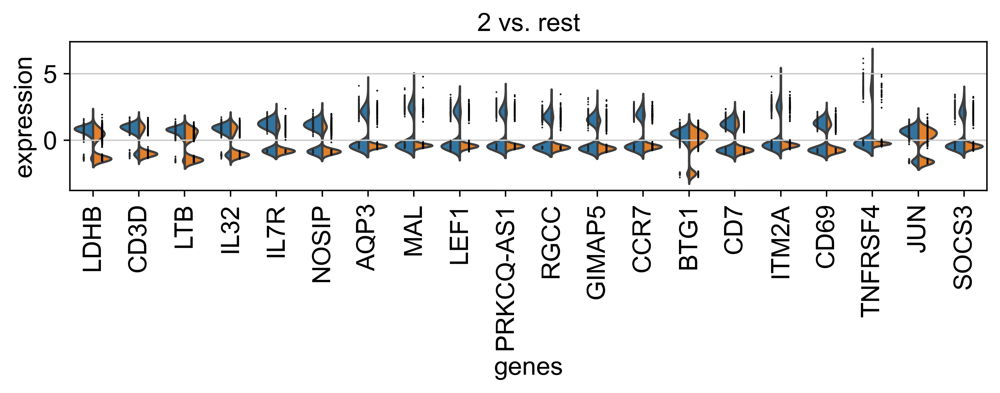

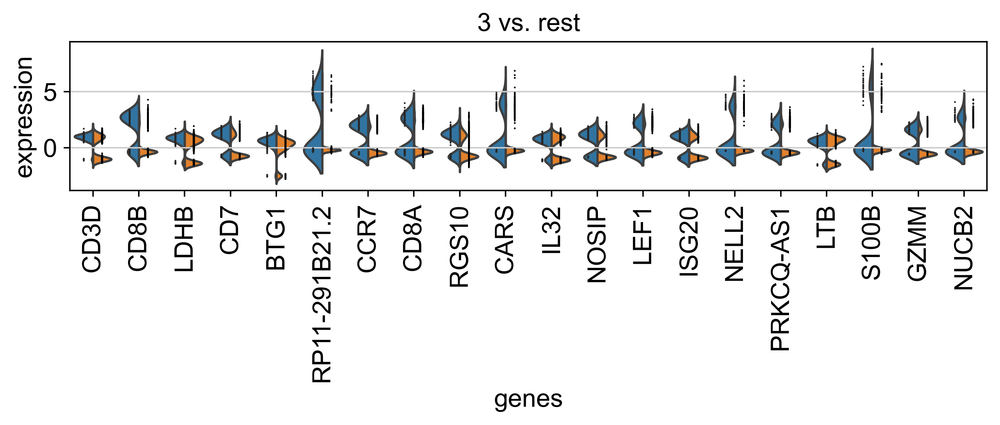

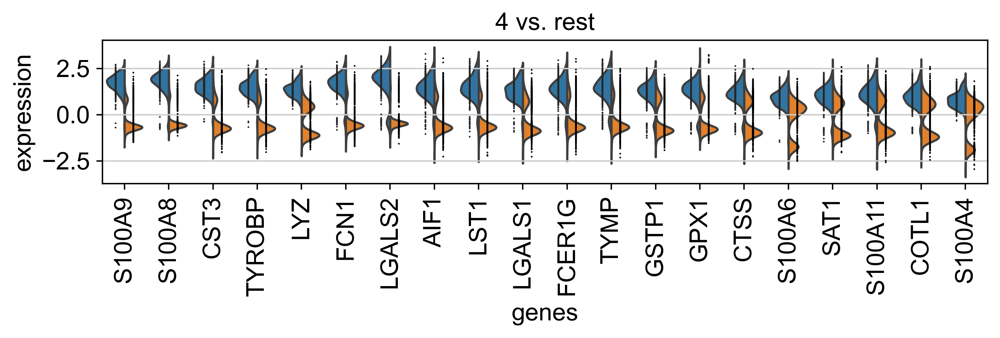

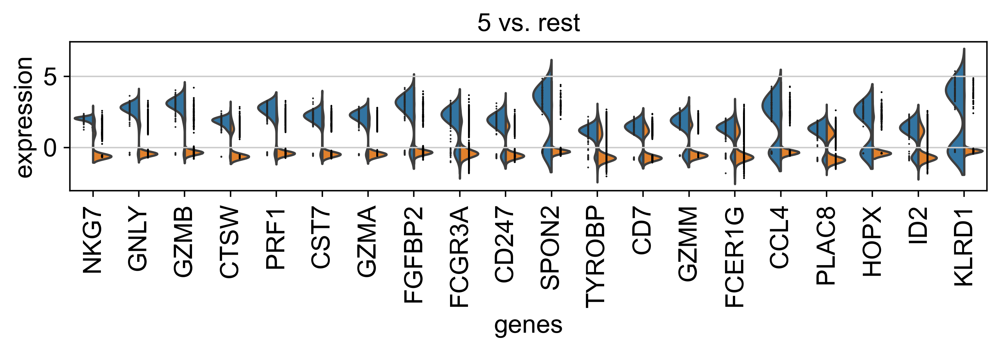

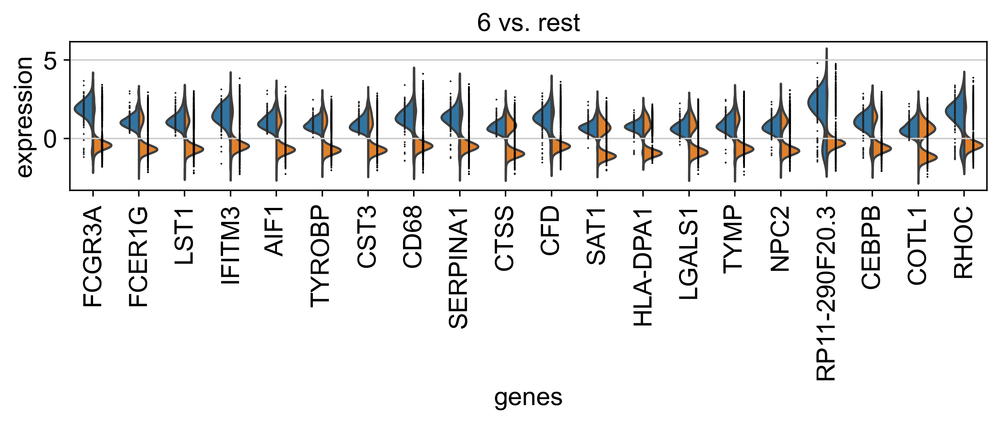

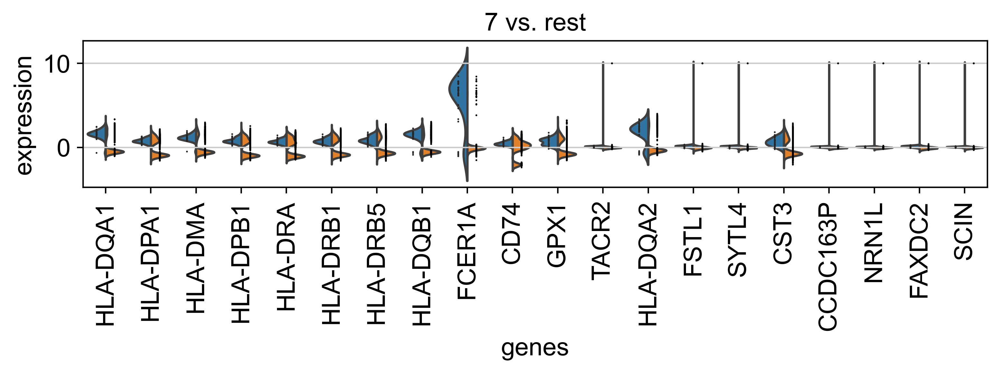

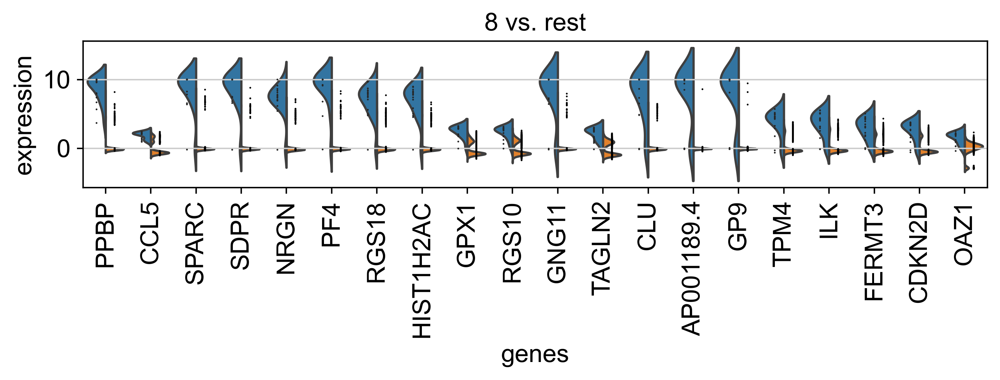

In [109]:
with rc_context({"figure.figsize": (9, 1.5)}):
    sc.pl.rank_genes_groups_violin(adata, n_genes=20, jitter=False)

categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.
categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

categories: 0, 1, 2, etc.
var_group_labels: B-cell, Dendritic, Monocytes, etc.


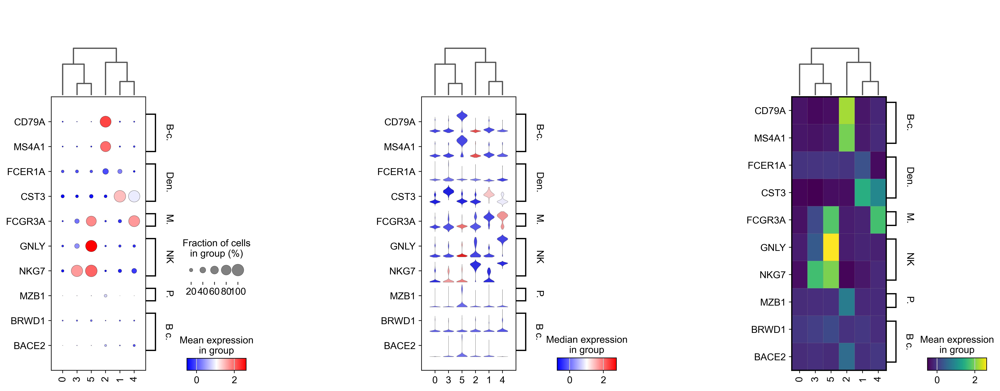

In [110]:
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 8), gridspec_kw={"wspace": 0.9},)

ax1_dict = sc.pl.dotplot(
    adata, marker_genes_dict,swap_axes=True, dendrogram=True, groupby="leiden_res0_5", ax=ax1,cmap="bwr", show=False
)
ax2_dict = sc.pl.stacked_violin(
    adata, marker_genes_dict,swap_axes=True, dendrogram=True, groupby="leiden_res0_5", ax=ax2, cmap="bwr",show=False
)
ax3_dict = sc.pl.matrixplot(
    adata, marker_genes_dict,swap_axes=True, dendrogram=True, groupby="leiden_res0_5", ax=ax3, show=False, cmap="viridis"
)

In [113]:
!pip install marsilea
import marsilea as ma
import marsilea.plotter as mp

adata = sc.datasets.pbmc3k_processed().raw.to_adata()



  Using cached marsilea-0.3.3-py3-none-any.whl (70 kB)
  Using cached legendkit-0.3.4-py3-none-any.whl (21 kB)


In [114]:
cell_markers = {
    "CD4 T cells": ["IL7R"],
    "CD14+ Monocytes": ["CD14", "LYZ"],
    "B cells": ["MS4A1"],
    "CD8 T cells": ["CD8A"],
    "NK cells": ["GNLY", "NKG7"],
    "FCGR3A+ Monocytes": ["FCGR3A", "MS4A7"],
    "Dendritic cells": ["FCER1A", "CST3"],
    "Megakaryocytes": ["PPBP"],
}

cells, markers = [], []
for c, ms in cell_markers.items():
    cells += [c] * len(ms)
    markers += ms

uni_cells = list(cell_markers.keys())
cell_colors = [
    "#568564",
    "#FFF3A7",
    "#F72464",
    "#005585",
    "#9876DE",
    "#405559",
    "#58DADA",
    "#F85959",
]
cmapper = dict(zip(uni_cells, cell_colors))

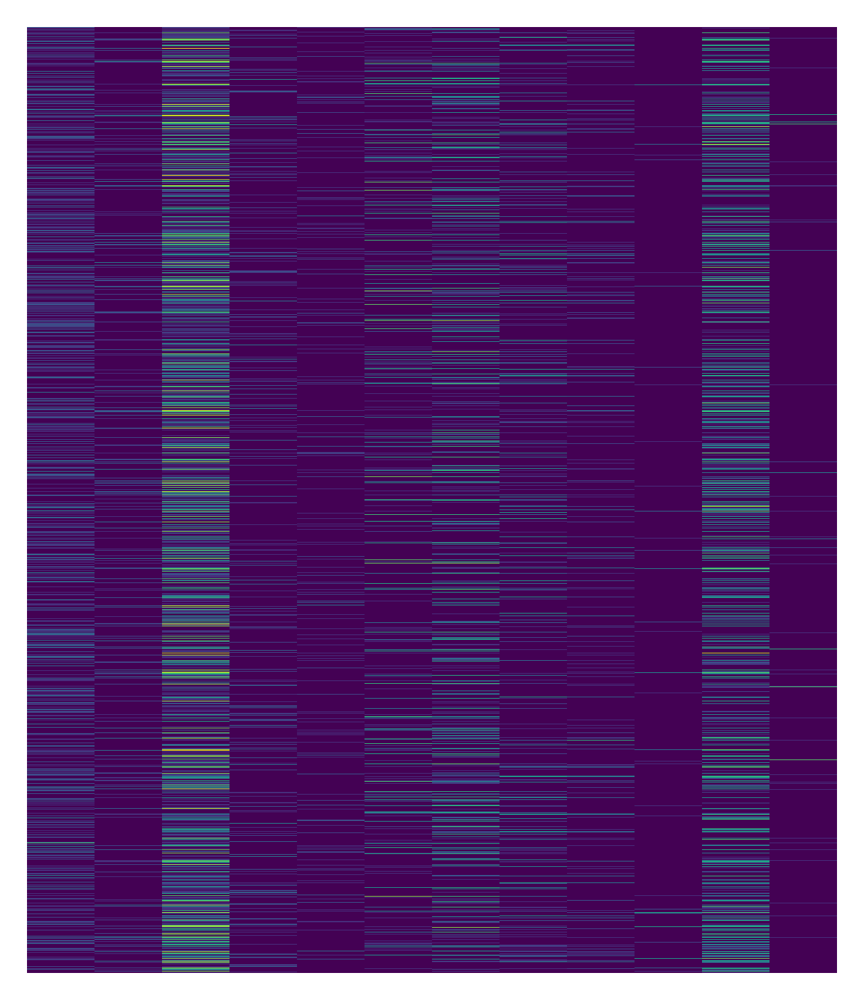

In [115]:
exp = adata[:, markers].X.toarray()

m = ma.Heatmap(exp, cmap="viridis", height=3.5, width=3)
m.render()

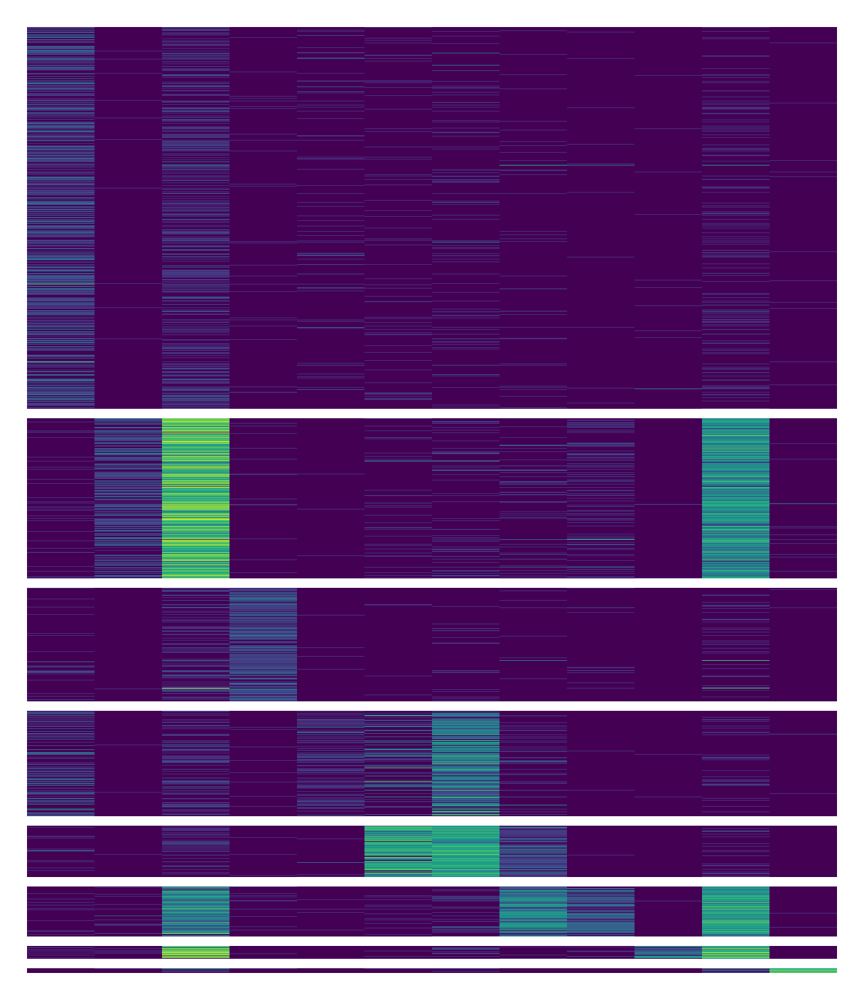

In [116]:
m.hsplit(labels=adata.obs["louvain"], order=uni_cells)
m.render()

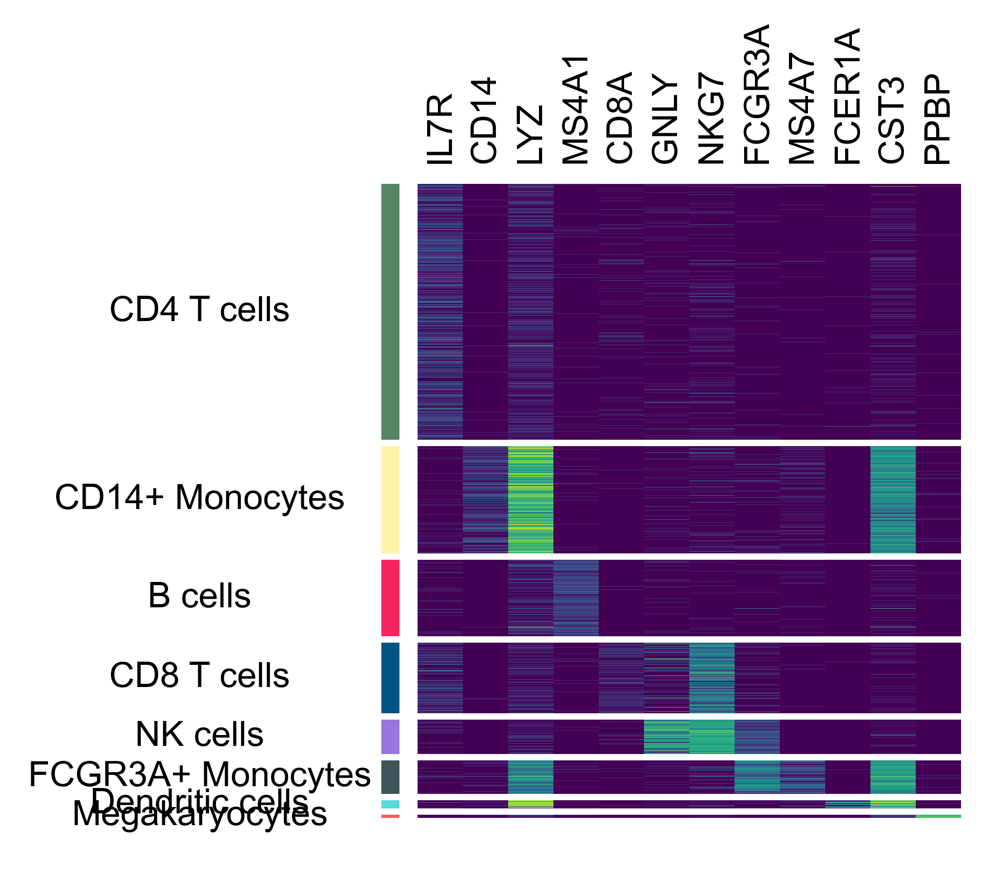

In [117]:
# Create plotters
chunk = mp.Chunk(uni_cells, rotation=0, align="center")
colors = mp.Colors(list(adata.obs["louvain"]), palette=cmapper)
label_markers = mp.Labels(markers)

# Add to the heatmap
m.add_left(colors, size=0.1, pad=0.1)
m.add_left(chunk)
m.add_top(label_markers, pad=0.1)
m.render()

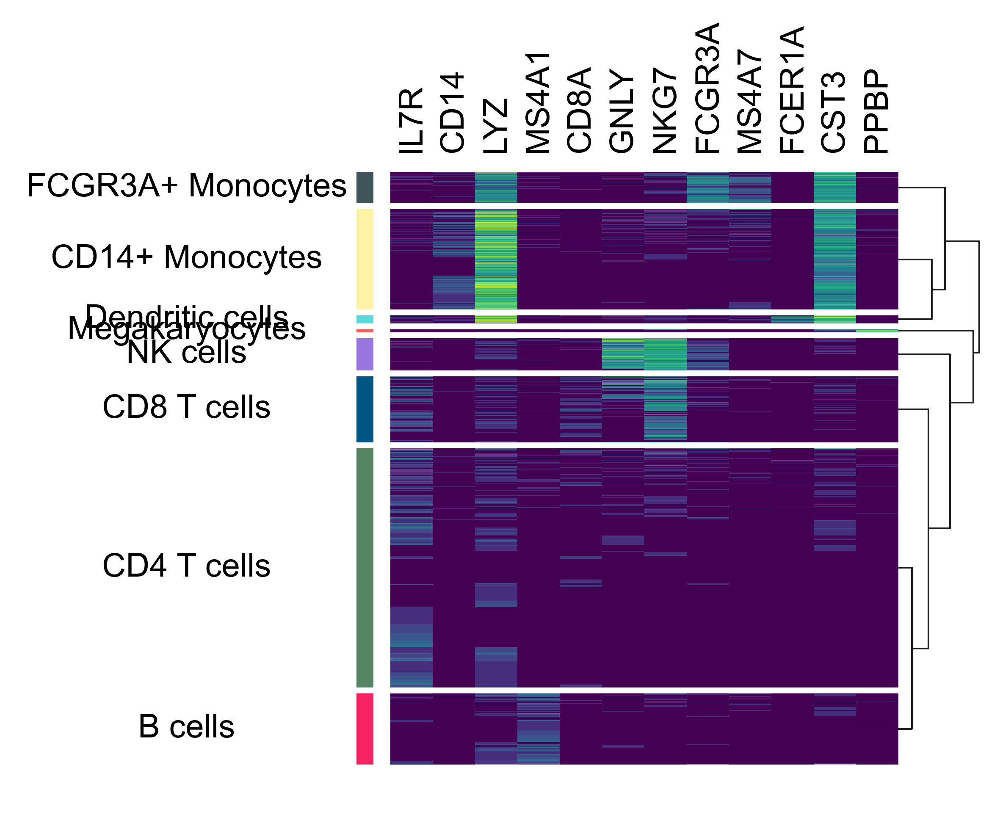

In [118]:
m.add_dendrogram("right", add_base=False)
m.render()

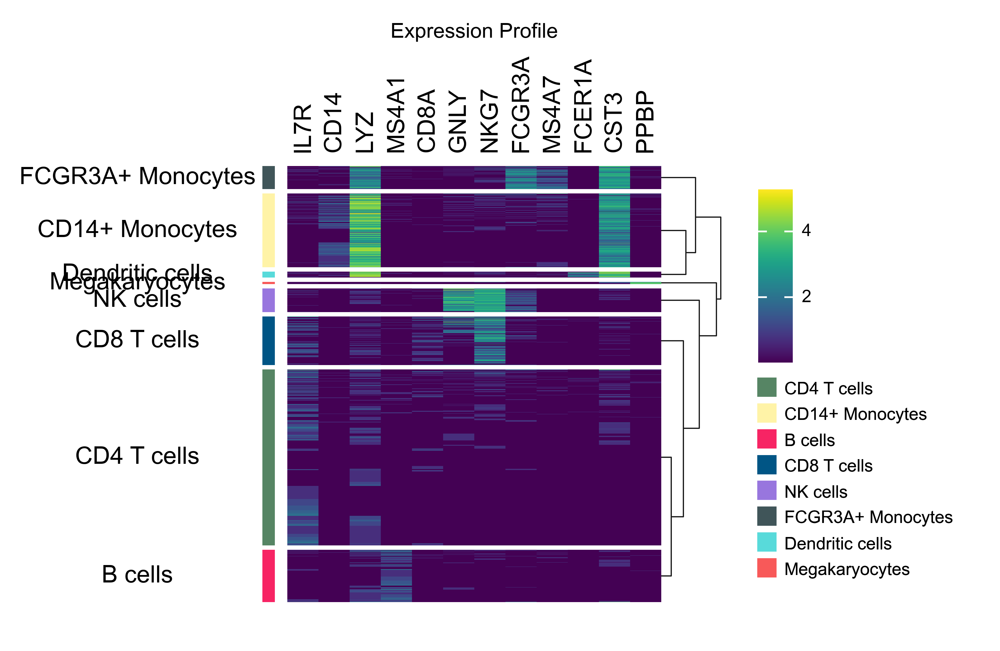

In [119]:
m.add_legends()
m.add_title("Expression Profile")
m.render()

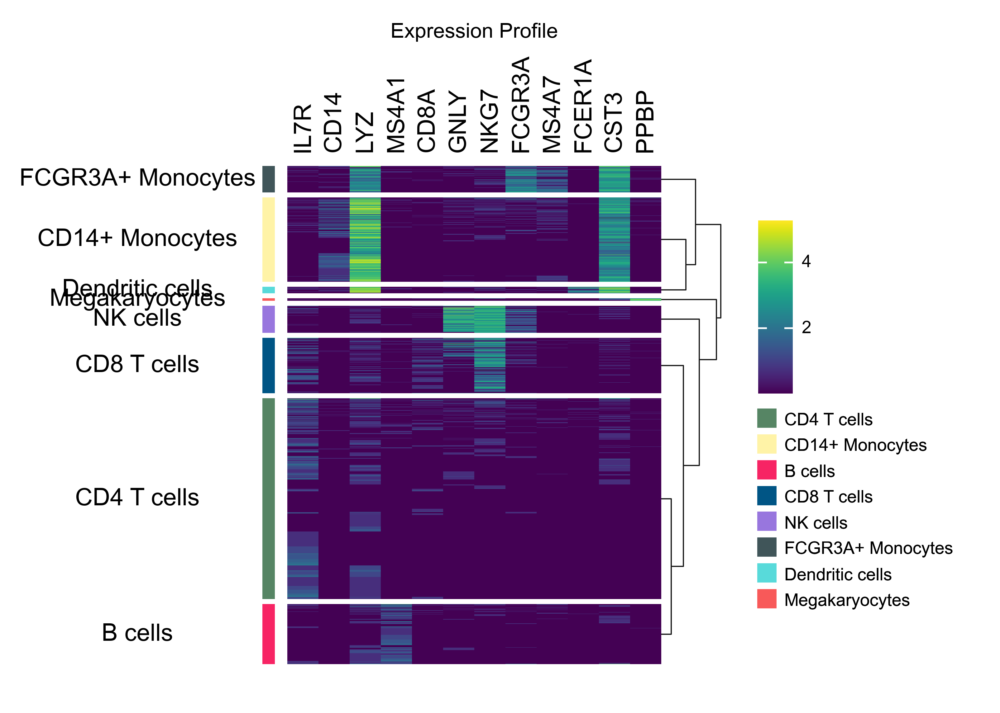

In [120]:
m = ma.Heatmap(exp, cmap="viridis", height=4, width=3)
m.hsplit(labels=adata.obs["louvain"], order=uni_cells)

m.add_left(
    mp.Colors(list(adata.obs["louvain"]), palette=cmapper),
    size=0.1,
    pad=0.1,
)
m.add_left(mp.Chunk(uni_cells, rotation=0, align="center"))
m.add_top(mp.Labels(markers), pad=0.1)
m.add_dendrogram("right", add_base=False)

m.add_legends()
m.add_title("Expression Profile")
m.render()

In [121]:
agg = sc.get.aggregate(adata[:, markers], by="louvain", func=["mean", "count_nonzero"])
agg.obs["cell_counts"] = adata.obs["louvain"].value_counts()
agg

AnnData object with n_obs × n_vars = 8 × 12
    obs: 'louvain', 'cell_counts'
    var: 'n_cells'
    layers: 'mean', 'count_nonzero'

In [122]:
exp = agg.layers["mean"]
count = agg.layers["count_nonzero"]
cell_counts = agg.obs["cell_counts"].to_numpy()

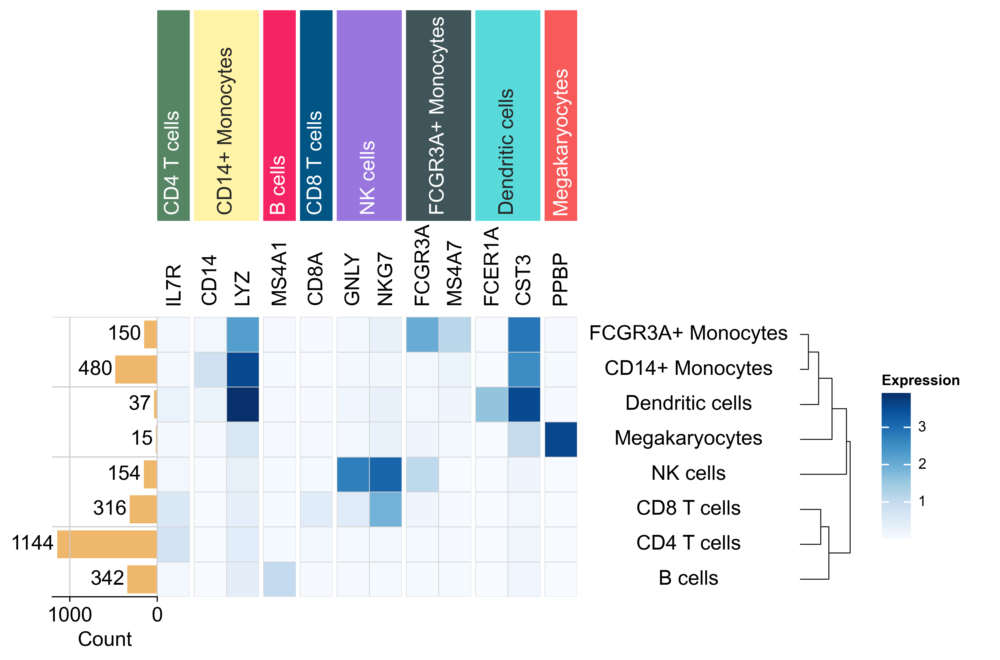

In [123]:
h, w = exp.shape

m = ma.Heatmap(
    exp,
    height=h / 3,
    width=w / 3,
    cmap="Blues",
    linewidth=0.5,
    linecolor="lightgray",
    label="Expression",
)
m.add_right(mp.Labels(agg.obs["louvain"], align="center"), pad=0.1)
m.add_top(mp.Labels(markers), pad=0.1)
m.vsplit(labels=cells, order=uni_cells)
m.add_top(mp.Chunk(uni_cells, fill_colors=cell_colors, rotation=90))
m.add_left(mp.Numbers(cell_counts, color="#EEB76B", label="Count"))
m.add_dendrogram("right", pad=0.1)
m.add_legends()
m.render()

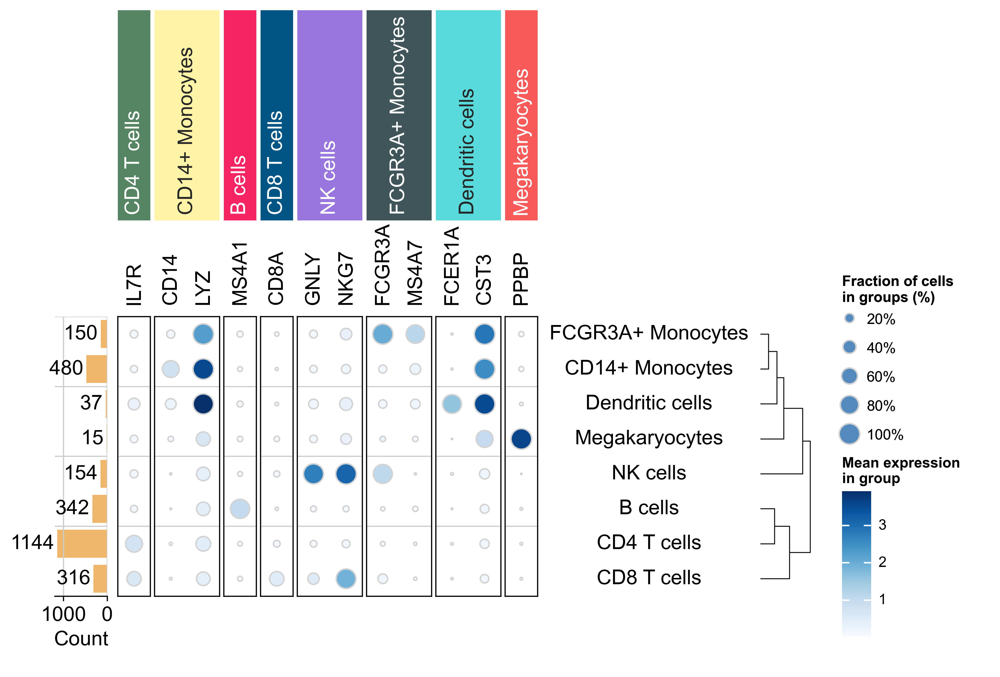

In [124]:
size = count / cell_counts[:, np.newaxis]
m = ma.SizedHeatmap(
    size=size,
    color=exp,
    cluster_data=size,
    height=h / 3,
    width=w / 3,
    edgecolor="lightgray",
    cmap="Blues",
    size_legend_kws=dict(
        colors="#538bbf",
        title="Fraction of cells\nin groups (%)",
        labels=["20%", "40%", "60%", "80%", "100%"],
        show_at=[0.2, 0.4, 0.6, 0.8, 1.0],
    ),
    color_legend_kws=dict(title="Mean expression\nin group"),
)

m.add_top(mp.Labels(markers), pad=0.1)
m.add_top(mp.Chunk(uni_cells, fill_colors=cell_colors, rotation=90))
m.vsplit(labels=cells, order=uni_cells)

m.add_right(mp.Labels(agg.obs["louvain"], align="center"), pad=0.1)
m.add_left(mp.Numbers(cell_counts, color="#EEB76B", label="Count"), size=0.5, pad=0.1)
m.add_dendrogram("right", pad=0.1)
m.add_legends()
m.render()